In [ ]:
!nvidia-smi

Mon Aug 23 16:58:07 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.57.02    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!ln -s /content/drive/MyDrive/core_plugs/ core_plugs
!cp -r ./core_plugs/raws/ ./raws
!python ./core_plugs/make_slices.py -i ./raws -o ./slices

Slice #1/11
2021-08-23 17:03:07.778238: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-23 17:03:08.294802: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-23 17:03:08.295441: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-23 17:03:08.311369: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-23 17:03:08.312001: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node

In [ ]:
#@title Parameters
#@markdown Forms support many types of fields.

slices_folder = './slices' #@param {type: "string"}
im_height = 250 #@param {type: "number"}
im_width =  250#@param {type: "number"}
seq_len = 1 #@param {type: "number"}
window_shift =  1#@param {type: "number"}
window_stride =  1#@param {type: "number"}
batch_size = 4 #@param {type: "number"}
num_epochs = 1000 #@param {type: "number"}
prefetch_num = -1 #@param
val_core_list = ['BB_2d25um_binary'] #@param
latent_dim =  128#@param {type: "number"}
dense_dim =  128#@param {type: "number"}
betta = 1 #@param {type: "number"}
#@markdown ---


In [ ]:
#'Berea_2d25um_binary', 'BanderaBrown_2d25um_binary', 'BanderaGray_2d25um_binary', 'Kirby_2d25um_binary',  'Parker_2d25um_binary'

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from core_plugs.dataset_of import read_dataset
from matplotlib import pyplot as plt
import numpy as np
import time
from tqdm import tqdm

plt.gray()

<Figure size 432x288 with 0 Axes>

In [ ]:
train_dataset, test_dataset, val_datasets = read_dataset(
    slices_folder,
    slices_type = tf.uint8,
    im_height=im_height,
    im_width=im_width,
    seq_len=seq_len,
    batch_size=batch_size,
    prefetch_num=prefetch_num,
    val_core_list = val_core_list,
    window_shift=window_shift,
    window_stride=window_stride)

In [ ]:
from_n = 500
to_n = 520

In [ ]:


train_dataset = val_datasets['BB_2d25um_binary'].take(from_n).concatenate(val_datasets['BB_2d25um_binary'].skip(to_n)) \
            .window(seq_len, shift=window_shift, stride=window_stride, drop_remainder=True) \
            .flat_map(lambda window: window.batch(seq_len))

train_dataset = train_dataset.shuffle(1000, reshuffle_each_iteration=True)

(4, 250, 250, 1)


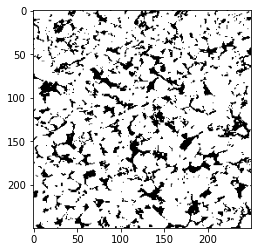

In [ ]:
for sl in train_dataset.take(1):
  print(sl.shape)
  plt.imshow(sl[0,:,:,0])
  plt.show()

In [ ]:
input_shape = None
for x in train_dataset.take(1):
    input_shape = x[0].shape
    
print(input_shape)

(250, 250, 1)


In [ ]:
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

encoder_inputs = keras.Input(shape=input_shape)
x = layers.Conv2D(32, 3, activation="relu", strides=2, padding="same")(encoder_inputs)
x = layers.Conv2D(64, 3, activation="relu", strides=2, padding="same")(x)
x = layers.Conv2D(128, 3, activation="relu", strides=2, padding="same")(x)
x = layers.Conv2D(256, 3, activation="relu", strides=2, padding="same")(x)
last_conv_shape = x.shape
# x = layers.Conv2D(512, 3, activation="relu", strides=2, padding="same")(x)
x = layers.Flatten()(x)
#x = layers.Dense(dense_dim, activation="relu")(x)
z_mean = layers.Dense(latent_dim, name="z_mean")(x)
z_log_var = layers.Dense(latent_dim, name="z_log_var")(x)
z = Sampling()([z_mean, z_log_var])
encoder = keras.Model(encoder_inputs, [z_mean, z_log_var, z], name="encoder")
encoder.summary()

latent_inputs = keras.Input(shape=(latent_dim,))
x = layers.Dense((last_conv_shape[1]) * (last_conv_shape[2]) * last_conv_shape[3], activation="relu")(latent_inputs)
x = layers.Reshape(last_conv_shape[1:])(x)
x = layers.Conv2DTranspose(256, 3, activation="relu", strides=2, padding="same")(x)
x = layers.Conv2DTranspose(128, 3, activation="relu", strides=2, padding="same")(x)
x = layers.Conv2DTranspose(64, 3, activation="relu", strides=2, padding="same")(x)
x = layers.Conv2DTranspose(32, 3, activation="relu", strides=2, padding="same")(x)
decoder_outputs = layers.Conv2D(1, 3, activation="sigmoid", padding="same")(x)
decoder_outputs_fixed_size = layers.Lambda(lambda x: tf.image.resize(x, input_shape[:-1]))(decoder_outputs)
decoder = keras.Model(latent_inputs, decoder_outputs_fixed_size, name="decoder")
decoder.summary()

Model: "encoder"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 250, 250, 1) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 125, 125, 32) 320         input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 63, 63, 64)   18496       conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 32, 32, 128)  73856       conv2d_1[0][0]                   
____________________________________________________________________________________________

In [ ]:
# def bce(gt, pred):
#   return tf.reduce_mean(
#       tf.reduce_sum(
#           tf.keras.losses.binary_crossentropy(gt, pred), axis=(2, 3)
#       )
#   )

@tf.function
def loss_func(x, betta):
  #return tf.reduce_mean(tf.square(t-p))
  z_mean, z_log_var, z = encoder(x)
  reconstruction = decoder(z)
  reconstruction_loss = tf.reduce_mean(
      tf.reduce_sum(
          keras.losses.binary_crossentropy(x, reconstruction), axis=(1, 2)
      )
  )
  #reconstruction_loss = tf.reduce_mean(keras.losses.binary_crossentropy(x, reconstruction))
  kl_loss = -0.5 * (1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var))
  kl_loss = tf.reduce_mean(tf.reduce_sum(kl_loss, axis=1))
  total_loss = reconstruction_loss + betta*kl_loss
  return total_loss, reconstruction, reconstruction_loss, kl_loss

mean_loss_train = tf.keras.metrics.Mean()
mean_loss_train_rec = tf.keras.metrics.Mean()
mean_loss_train_kl = tf.keras.metrics.Mean()
mean_loss_test = tf.keras.metrics.Mean()

optimizer = tf.keras.optimizers.Adam(learning_rate=1e-5)

@tf.function
def training_step(x, betta):
    with tf.GradientTape() as tape:
        loss, _, rec_loss, kl_loss = loss_func(x, betta)
    grads = tape.gradient(loss, encoder.trainable_variables + decoder.trainable_variables)
    optimizer.apply_gradients(zip(grads, encoder.trainable_variables + decoder.trainable_variables))
    mean_loss_train(loss)
    mean_loss_train_rec(rec_loss)
    mean_loss_train_kl(kl_loss)

In [ ]:
def train(num_epochs, save_per = 10, betta = 1):
  betta = tf.constant(betta, dtype=tf.float32)

  for epoch in range(num_epochs):
    for x in tqdm(train_dataset):
        training_step(x, betta)
        
    train_x = x
        
    for x in test_dataset:
        loss, reconstruction, _, _ = loss_func(x, betta)
        mean_loss_test(loss)
        
    print(f'Epoch #{epoch}: Loss {mean_loss_train.result()}, Rec-Loss {mean_loss_train_rec.result()}, KL-Loss {mean_loss_train_kl.result()}, Test loss {mean_loss_test.result()}')
    
    fig = plt.figure()
    
    fig.add_subplot(1,2,1)
    plt.imshow(x[0,:,:,0])
    fig.add_subplot(1,2,2)
    plt.imshow(reconstruction[0,:,:,0])
    plt.show()
    
    mean_loss_train.reset_states()
    mean_loss_train_rec.reset_states()
    mean_loss_train_kl.reset_states()
    mean_loss_test.reset_states()

    if epoch % save_per == 0:
      encoder.save_weights(f'./core_plugs/models_vae_250_tt/encoder_epoch_{epoch}.ckpt')
      decoder.save_weights(f'./core_plugs/models_vae_250_tt/decoder_epoch_{epoch}.ckpt')

2000it [01:05, 30.31it/s]


Epoch #0: Loss 19792.501953125, Rec-Loss 19362.826171875, KL-Loss 429.6610107421875, Test loss 19691.1171875


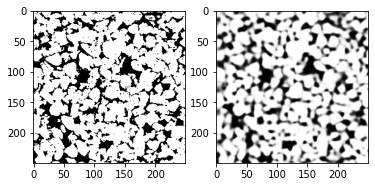

2000it [00:41, 48.78it/s]


Epoch #1: Loss 19176.580078125, Rec-Loss 18743.814453125, KL-Loss 432.7698059082031, Test loss 19215.00390625


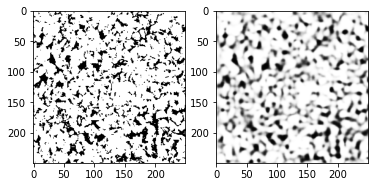

2000it [00:33, 58.95it/s]


Epoch #2: Loss 18665.349609375, Rec-Loss 18229.966796875, KL-Loss 435.3848571777344, Test loss 18780.8671875


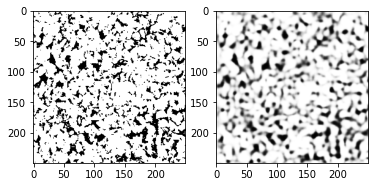

2000it [00:33, 58.84it/s]


Epoch #3: Loss 18225.556640625, Rec-Loss 17787.345703125, KL-Loss 438.1965637207031, Test loss 18416.056640625


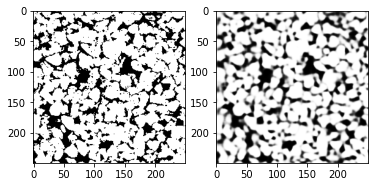

2000it [00:34, 58.74it/s]


Epoch #4: Loss 17846.421875, Rec-Loss 17406.287109375, KL-Loss 440.1407775878906, Test loss 18091.029296875


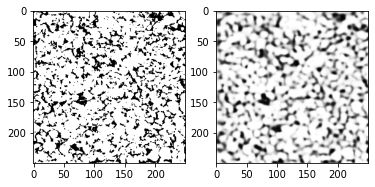

2000it [00:34, 58.48it/s]


Epoch #5: Loss 17508.14453125, Rec-Loss 17066.30078125, KL-Loss 441.83343505859375, Test loss 17787.712890625


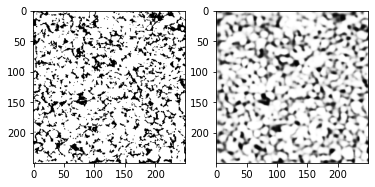

2000it [00:34, 58.54it/s]


Epoch #6: Loss 17210.046875, Rec-Loss 16766.1484375, KL-Loss 443.8911437988281, Test loss 17521.45703125


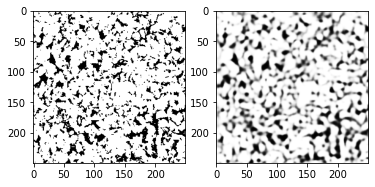

2000it [00:41, 48.78it/s]


Epoch #7: Loss 16940.666015625, Rec-Loss 16495.048828125, KL-Loss 445.6143493652344, Test loss 17284.486328125


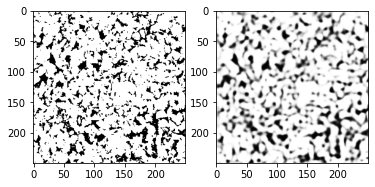

2000it [00:41, 48.77it/s]


Epoch #8: Loss 16692.009765625, Rec-Loss 16244.560546875, KL-Loss 447.41961669921875, Test loss 17069.068359375


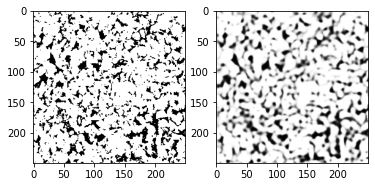

2000it [00:34, 58.34it/s]


Epoch #9: Loss 16469.04296875, Rec-Loss 16019.7646484375, KL-Loss 449.2734680175781, Test loss 16876.984375


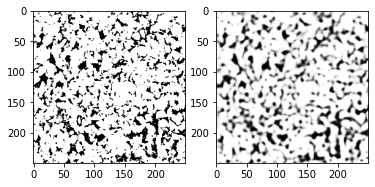

2000it [00:34, 58.37it/s]


Epoch #10: Loss 16263.0673828125, Rec-Loss 15812.296875, KL-Loss 450.7795715332031, Test loss 16682.6484375


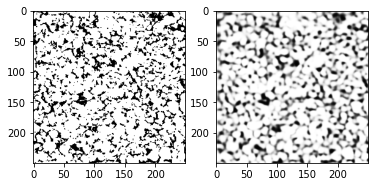

2000it [00:41, 48.77it/s]


Epoch #11: Loss 16073.2275390625, Rec-Loss 15620.8037109375, KL-Loss 452.42041015625, Test loss 16513.2109375


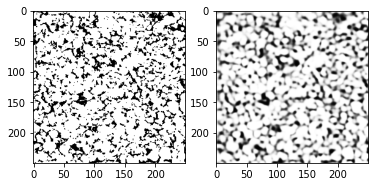

2000it [00:41, 48.76it/s]


Epoch #12: Loss 15893.072265625, Rec-Loss 15439.2783203125, KL-Loss 453.7789611816406, Test loss 16349.9970703125


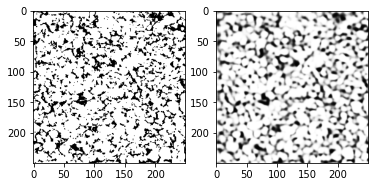

2000it [00:34, 58.37it/s]


Epoch #13: Loss 15725.1572265625, Rec-Loss 15270.583984375, KL-Loss 454.5574035644531, Test loss 16202.369140625


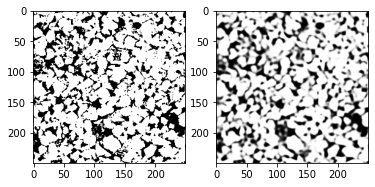

2000it [00:34, 58.17it/s]


Epoch #14: Loss 15568.8046875, Rec-Loss 15112.9716796875, KL-Loss 455.82763671875, Test loss 16046.5478515625


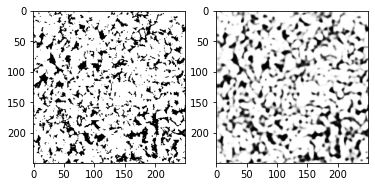

2000it [00:34, 58.34it/s]


Epoch #15: Loss 15418.734375, Rec-Loss 14961.6103515625, KL-Loss 457.1297302246094, Test loss 15914.828125


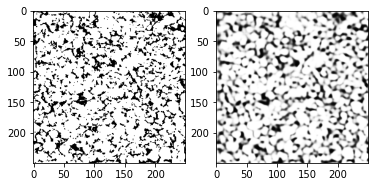

2000it [00:34, 58.13it/s]


Epoch #16: Loss 15282.0712890625, Rec-Loss 14823.4638671875, KL-Loss 458.5960998535156, Test loss 15795.6806640625


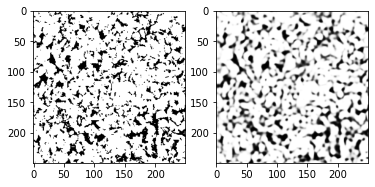

2000it [00:34, 58.17it/s]


Epoch #17: Loss 15144.126953125, Rec-Loss 14684.5546875, KL-Loss 459.5676574707031, Test loss 15664.3671875


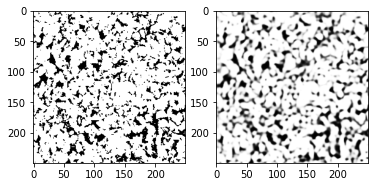

2000it [00:41, 48.75it/s]


Epoch #18: Loss 15018.755859375, Rec-Loss 14557.9970703125, KL-Loss 460.75848388671875, Test loss 15534.23828125


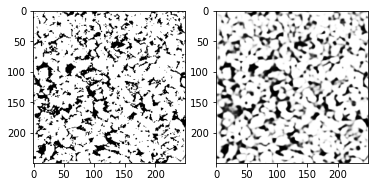

2000it [00:34, 57.99it/s]


Epoch #19: Loss 14897.751953125, Rec-Loss 14436.03125, KL-Loss 461.7261657714844, Test loss 15434.46875


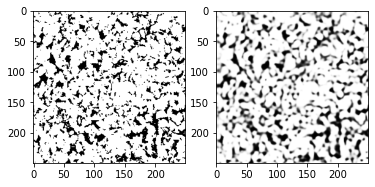

2000it [00:41, 48.78it/s]


Epoch #20: Loss 14780.7666015625, Rec-Loss 14318.2001953125, KL-Loss 462.53955078125, Test loss 15327.302734375


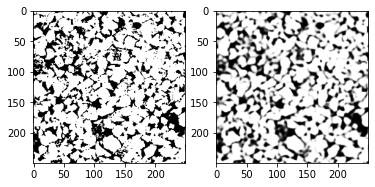

2000it [00:34, 58.16it/s]


Epoch #21: Loss 14668.8427734375, Rec-Loss 14205.1279296875, KL-Loss 463.71124267578125, Test loss 15223.16015625


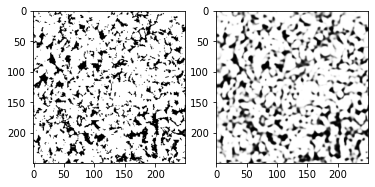

2000it [00:41, 48.77it/s]


Epoch #22: Loss 14562.6103515625, Rec-Loss 14098.3779296875, KL-Loss 464.24383544921875, Test loss 15120.46875


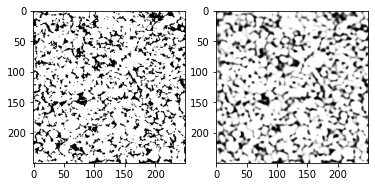

2000it [00:41, 48.76it/s]


Epoch #23: Loss 14460.8984375, Rec-Loss 13995.5537109375, KL-Loss 465.34625244140625, Test loss 15041.7548828125


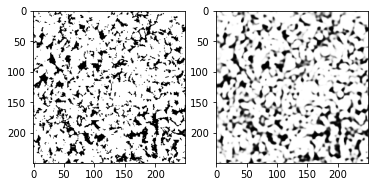

2000it [00:34, 58.15it/s]


Epoch #24: Loss 14360.9755859375, Rec-Loss 13894.822265625, KL-Loss 466.14794921875, Test loss 14940.361328125


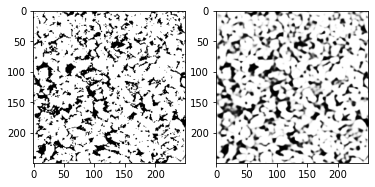

2000it [00:34, 57.95it/s]


Epoch #25: Loss 14267.650390625, Rec-Loss 13800.5087890625, KL-Loss 467.1515197753906, Test loss 14838.673828125


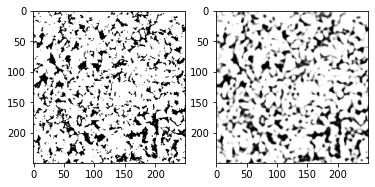

2000it [00:34, 57.88it/s]


Epoch #26: Loss 14175.84375, Rec-Loss 13707.6494140625, KL-Loss 468.1815490722656, Test loss 14760.24609375


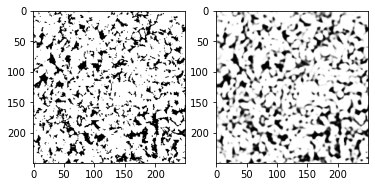

2000it [00:41, 48.75it/s]


Epoch #27: Loss 14088.658203125, Rec-Loss 13619.861328125, KL-Loss 468.7952880859375, Test loss 14691.1201171875


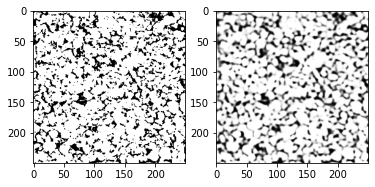

2000it [00:34, 58.07it/s]


Epoch #28: Loss 14002.572265625, Rec-Loss 13532.78515625, KL-Loss 469.78826904296875, Test loss 14624.544921875


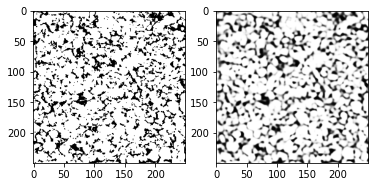

2000it [00:34, 57.79it/s]


Epoch #29: Loss 13919.806640625, Rec-Loss 13449.4853515625, KL-Loss 470.3351135253906, Test loss 14551.3642578125


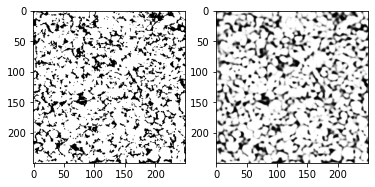

2000it [00:34, 57.87it/s]


Epoch #30: Loss 13841.7119140625, Rec-Loss 13370.49609375, KL-Loss 471.1938171386719, Test loss 14473.8759765625


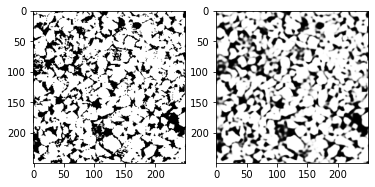

2000it [00:34, 57.91it/s]


Epoch #31: Loss 13763.2646484375, Rec-Loss 13291.19140625, KL-Loss 472.0754699707031, Test loss 14401.275390625


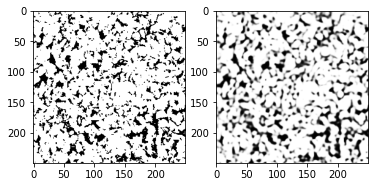

2000it [00:41, 48.76it/s]


Epoch #32: Loss 13689.4169921875, Rec-Loss 13216.736328125, KL-Loss 472.675537109375, Test loss 14328.0849609375


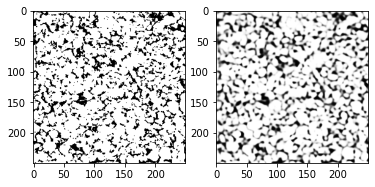

2000it [00:35, 57.04it/s]


Epoch #33: Loss 13618.7119140625, Rec-Loss 13144.8935546875, KL-Loss 473.816162109375, Test loss 14250.0517578125


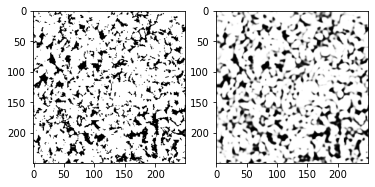

2000it [00:41, 48.78it/s]


Epoch #34: Loss 13546.15625, Rec-Loss 13071.66796875, KL-Loss 474.4896545410156, Test loss 14193.73828125


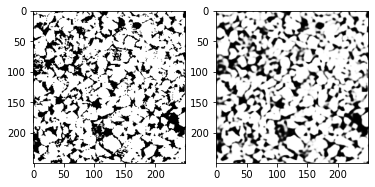

2000it [00:34, 57.90it/s]


Epoch #35: Loss 13477.5732421875, Rec-Loss 13002.2158203125, KL-Loss 475.3572082519531, Test loss 14151.6162109375


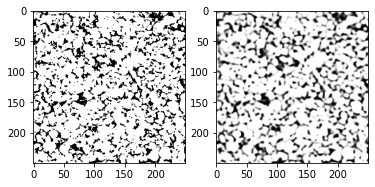

2000it [00:34, 57.65it/s]


Epoch #36: Loss 13411.6650390625, Rec-Loss 12935.9208984375, KL-Loss 475.73553466796875, Test loss 14063.9833984375


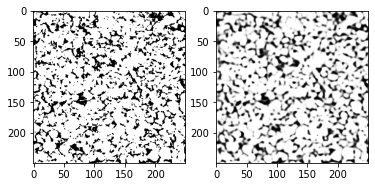

2000it [00:41, 48.76it/s]


Epoch #37: Loss 13348.080078125, Rec-Loss 12871.3837890625, KL-Loss 476.67205810546875, Test loss 14012.5419921875


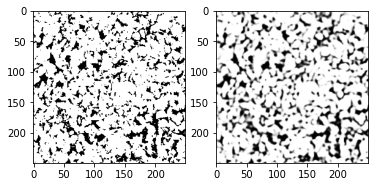

2000it [00:34, 57.82it/s]


Epoch #38: Loss 13281.21484375, Rec-Loss 12803.55859375, KL-Loss 477.6593933105469, Test loss 13955.609375


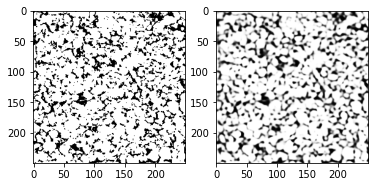

2000it [00:34, 57.80it/s]


Epoch #39: Loss 13220.7841796875, Rec-Loss 12742.80859375, KL-Loss 477.95574951171875, Test loss 13905.4423828125


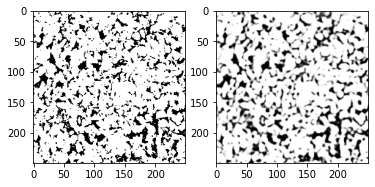

2000it [00:34, 57.60it/s]


Epoch #40: Loss 13160.384765625, Rec-Loss 12681.54296875, KL-Loss 478.8682556152344, Test loss 13844.5166015625


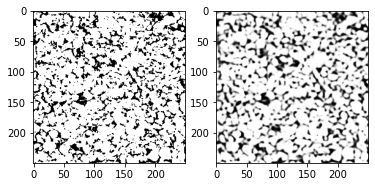

2000it [00:34, 57.67it/s]


Epoch #41: Loss 13102.5439453125, Rec-Loss 12623.0419921875, KL-Loss 479.5133972167969, Test loss 13792.109375


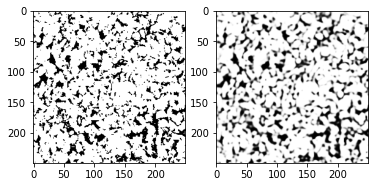

2000it [00:34, 57.63it/s]


Epoch #42: Loss 13046.265625, Rec-Loss 12565.9638671875, KL-Loss 480.2915344238281, Test loss 13746.7470703125


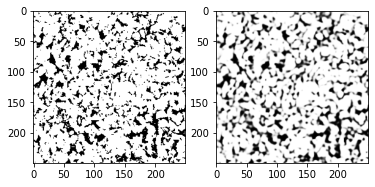

2000it [00:34, 57.63it/s]


Epoch #43: Loss 12989.8466796875, Rec-Loss 12509.0126953125, KL-Loss 480.83123779296875, Test loss 13706.5439453125


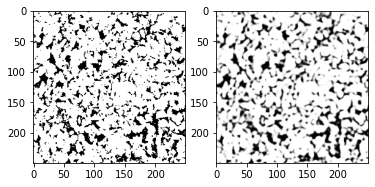

2000it [00:34, 57.91it/s]


Epoch #44: Loss 12933.6484375, Rec-Loss 12452.005859375, KL-Loss 481.6495666503906, Test loss 13642.0498046875


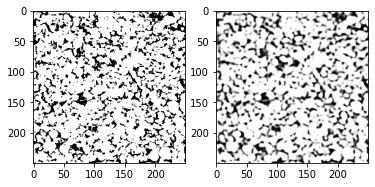

2000it [00:34, 58.02it/s]


Epoch #45: Loss 12882.1708984375, Rec-Loss 12400.1240234375, KL-Loss 482.04840087890625, Test loss 13600.6640625


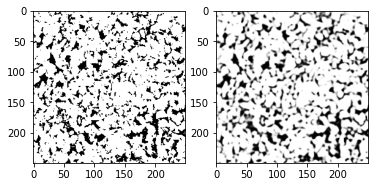

2000it [00:41, 48.77it/s]


Epoch #46: Loss 12829.4765625, Rec-Loss 12346.81640625, KL-Loss 482.6379089355469, Test loss 13546.361328125


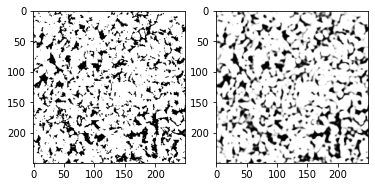

2000it [00:34, 57.99it/s]


Epoch #47: Loss 12777.328125, Rec-Loss 12294.14453125, KL-Loss 483.1932067871094, Test loss 13505.697265625


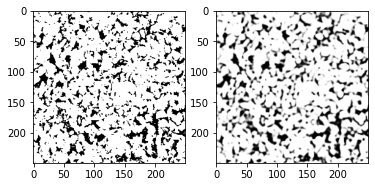

2000it [00:34, 57.76it/s]


Epoch #48: Loss 12727.7607421875, Rec-Loss 12244.220703125, KL-Loss 483.5494384765625, Test loss 13449.5830078125


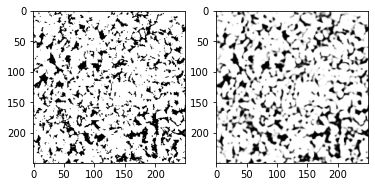

2000it [00:41, 48.76it/s]


Epoch #49: Loss 12677.6826171875, Rec-Loss 12193.5400390625, KL-Loss 484.13897705078125, Test loss 13415.2841796875


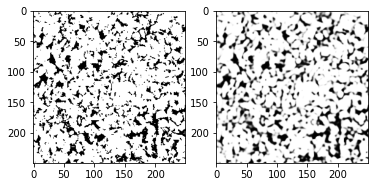

2000it [00:34, 57.79it/s]


Epoch #50: Loss 12629.8828125, Rec-Loss 12145.2861328125, KL-Loss 484.5942687988281, Test loss 13357.4697265625


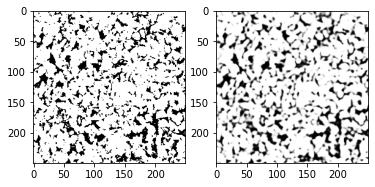

2000it [00:34, 57.72it/s]


Epoch #51: Loss 12583.2841796875, Rec-Loss 12097.6474609375, KL-Loss 485.6387939453125, Test loss 13342.0185546875


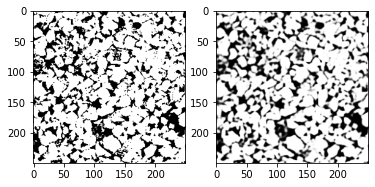

2000it [00:34, 57.44it/s]


Epoch #52: Loss 12538.251953125, Rec-Loss 12052.369140625, KL-Loss 485.8800048828125, Test loss 13295.8984375


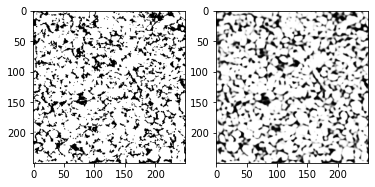

2000it [00:34, 57.44it/s]


Epoch #53: Loss 12491.876953125, Rec-Loss 12005.0869140625, KL-Loss 486.7866516113281, Test loss 13249.0693359375


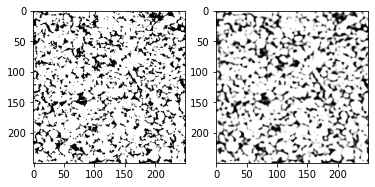

2000it [00:34, 57.52it/s]


Epoch #54: Loss 12446.8203125, Rec-Loss 11959.6318359375, KL-Loss 487.1973571777344, Test loss 13205.5595703125


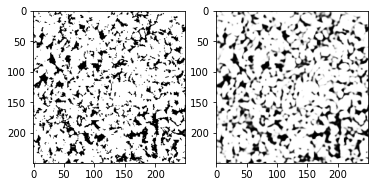

2000it [00:34, 57.39it/s]


Epoch #55: Loss 12403.603515625, Rec-Loss 11915.8525390625, KL-Loss 487.7556457519531, Test loss 13171.576171875


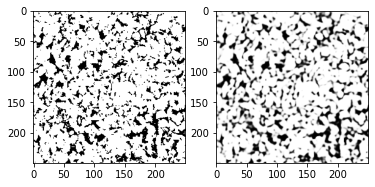

2000it [00:34, 57.38it/s]


Epoch #56: Loss 12360.4345703125, Rec-Loss 11872.1982421875, KL-Loss 488.2320556640625, Test loss 13115.5576171875


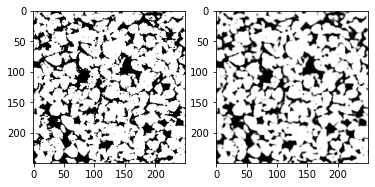

2000it [00:34, 57.52it/s]


Epoch #57: Loss 12319.4638671875, Rec-Loss 11830.62890625, KL-Loss 488.82757568359375, Test loss 13108.9287109375


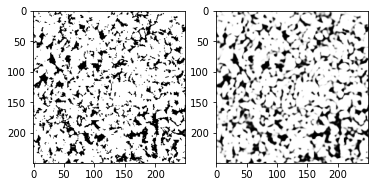

2000it [00:35, 56.59it/s]


Epoch #58: Loss 12277.87890625, Rec-Loss 11788.7998046875, KL-Loss 489.08349609375, Test loss 13054.873046875


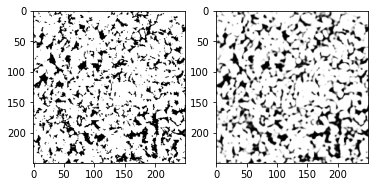

2000it [00:35, 56.87it/s]


Epoch #59: Loss 12238.66796875, Rec-Loss 11749.0224609375, KL-Loss 489.6624450683594, Test loss 13022.552734375


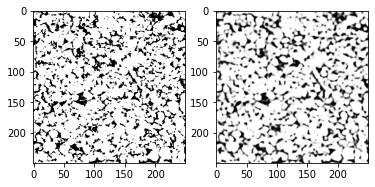

2000it [00:34, 57.22it/s]


Epoch #60: Loss 12198.8369140625, Rec-Loss 11708.666015625, KL-Loss 490.1782531738281, Test loss 13003.330078125


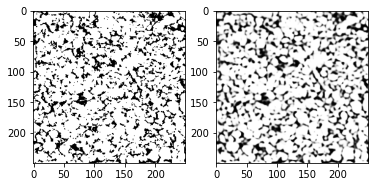

2000it [00:34, 57.21it/s]


Epoch #61: Loss 12160.279296875, Rec-Loss 11669.7998046875, KL-Loss 490.4755859375, Test loss 12956.630859375


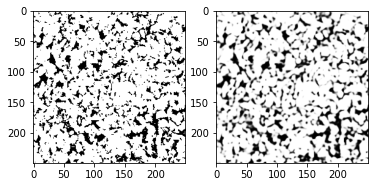

2000it [00:34, 57.17it/s]


Epoch #62: Loss 12121.0810546875, Rec-Loss 11630.216796875, KL-Loss 490.86590576171875, Test loss 12919.6259765625


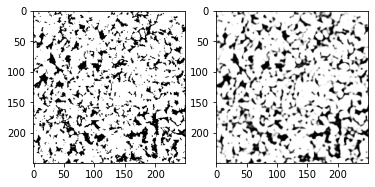

2000it [00:34, 57.47it/s]


Epoch #63: Loss 12085.4609375, Rec-Loss 11594.322265625, KL-Loss 491.1476135253906, Test loss 12883.5498046875


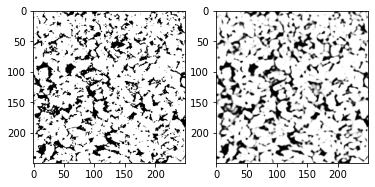

2000it [00:41, 48.75it/s]


Epoch #64: Loss 12050.927734375, Rec-Loss 11558.8505859375, KL-Loss 492.0818176269531, Test loss 12861.0966796875


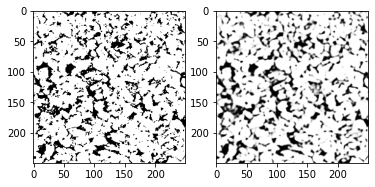

2000it [00:34, 57.66it/s]


Epoch #65: Loss 12011.65234375, Rec-Loss 11519.142578125, KL-Loss 492.53057861328125, Test loss 12819.8203125


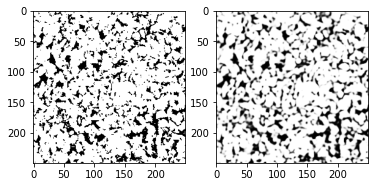

2000it [00:34, 57.91it/s]


Epoch #66: Loss 11979.4658203125, Rec-Loss 11486.66015625, KL-Loss 492.7923889160156, Test loss 12789.4638671875


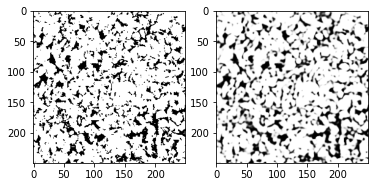

2000it [00:34, 57.65it/s]


Epoch #67: Loss 11944.2041015625, Rec-Loss 11451.228515625, KL-Loss 492.9825134277344, Test loss 12763.484375


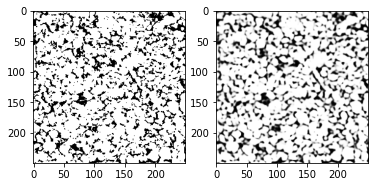

2000it [00:34, 57.70it/s]


Epoch #68: Loss 11907.7763671875, Rec-Loss 11414.28125, KL-Loss 493.49365234375, Test loss 12739.52734375


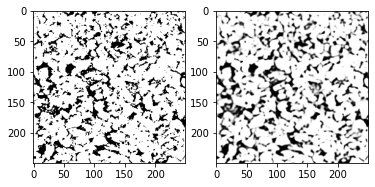

2000it [00:34, 57.77it/s]


Epoch #69: Loss 11878.9716796875, Rec-Loss 11385.162109375, KL-Loss 493.8077697753906, Test loss 12697.8642578125


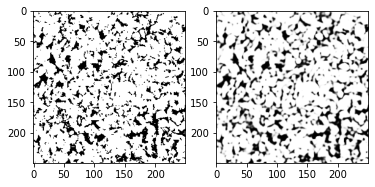

2000it [00:34, 57.85it/s]


Epoch #70: Loss 11843.3740234375, Rec-Loss 11349.2041015625, KL-Loss 494.16339111328125, Test loss 12670.2939453125


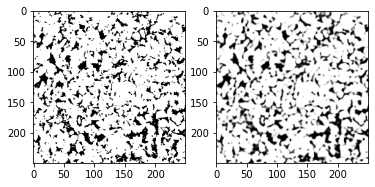

2000it [00:34, 57.74it/s]


Epoch #71: Loss 11811.3486328125, Rec-Loss 11316.9541015625, KL-Loss 494.396728515625, Test loss 12651.701171875


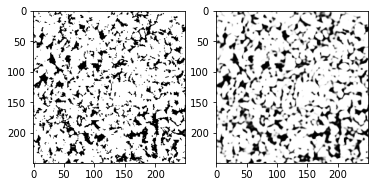

2000it [00:34, 57.61it/s]


Epoch #72: Loss 11780.880859375, Rec-Loss 11285.91015625, KL-Loss 494.9624938964844, Test loss 12620.455078125


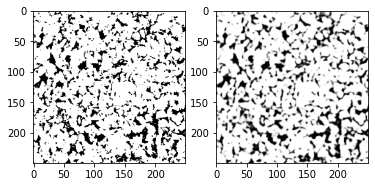

2000it [00:34, 57.62it/s]


Epoch #73: Loss 11750.48828125, Rec-Loss 11255.244140625, KL-Loss 495.2479553222656, Test loss 12615.1865234375


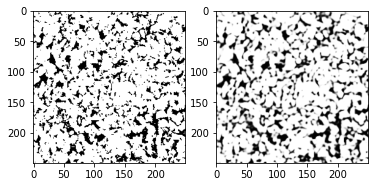

2000it [00:34, 57.77it/s]


Epoch #74: Loss 11718.9931640625, Rec-Loss 11223.2880859375, KL-Loss 495.7001037597656, Test loss 12578.943359375


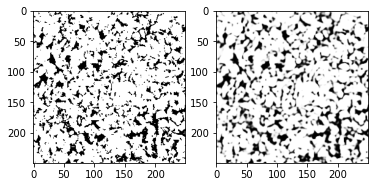

2000it [00:34, 57.86it/s]


Epoch #75: Loss 11690.888671875, Rec-Loss 11194.931640625, KL-Loss 495.95391845703125, Test loss 12547.8974609375


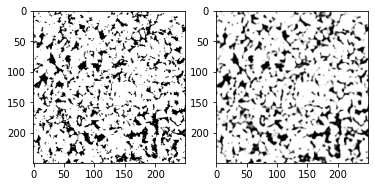

2000it [00:34, 57.80it/s]


Epoch #76: Loss 11661.3984375, Rec-Loss 11165.025390625, KL-Loss 496.3783264160156, Test loss 12518.697265625


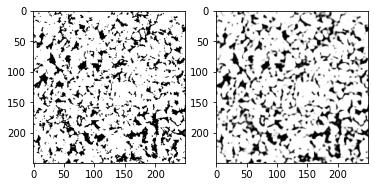

2000it [00:34, 58.10it/s]


Epoch #77: Loss 11631.4423828125, Rec-Loss 11134.5595703125, KL-Loss 496.8905029296875, Test loss 12482.0185546875


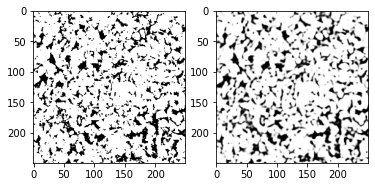

2000it [00:34, 57.90it/s]


Epoch #78: Loss 11603.748046875, Rec-Loss 11107.0068359375, KL-Loss 496.7510681152344, Test loss 12472.4833984375


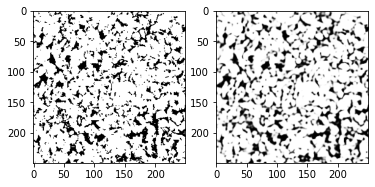

2000it [00:34, 57.86it/s]


Epoch #79: Loss 11575.05859375, Rec-Loss 11077.9716796875, KL-Loss 497.0684814453125, Test loss 12443.5322265625


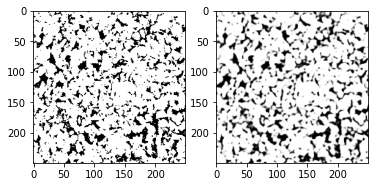

2000it [00:34, 57.95it/s]


Epoch #80: Loss 11548.3671875, Rec-Loss 11050.728515625, KL-Loss 497.6407165527344, Test loss 12431.3603515625


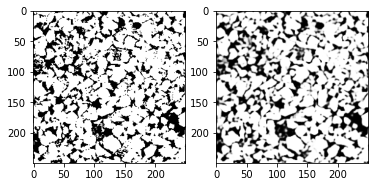

2000it [00:41, 48.77it/s]


Epoch #81: Loss 11520.1669921875, Rec-Loss 11022.2412109375, KL-Loss 497.9488525390625, Test loss 12403.333984375


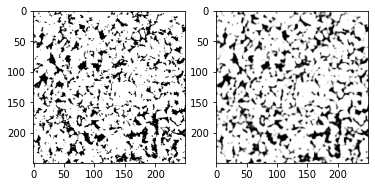

2000it [00:34, 57.88it/s]


Epoch #82: Loss 11493.849609375, Rec-Loss 10995.8203125, KL-Loss 498.0266418457031, Test loss 12400.2412109375


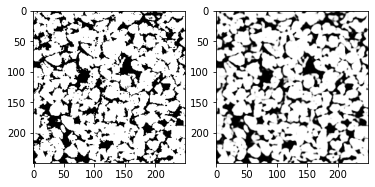

2000it [00:34, 57.35it/s]


Epoch #83: Loss 11467.4580078125, Rec-Loss 10968.98828125, KL-Loss 498.47479248046875, Test loss 12357.2265625


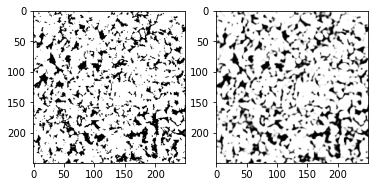

2000it [00:34, 57.40it/s]


Epoch #84: Loss 11442.626953125, Rec-Loss 10943.9990234375, KL-Loss 498.62152099609375, Test loss 12344.9736328125


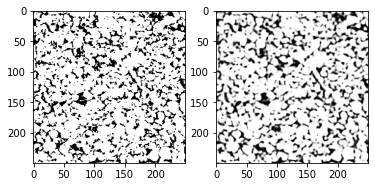

2000it [00:34, 57.83it/s]


Epoch #85: Loss 11416.40625, Rec-Loss 10917.44921875, KL-Loss 498.9447326660156, Test loss 12324.271484375


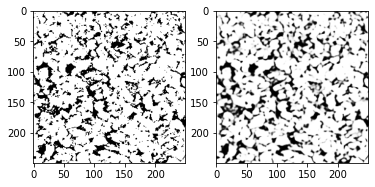

2000it [00:41, 48.77it/s]


Epoch #86: Loss 11392.9462890625, Rec-Loss 10893.8876953125, KL-Loss 499.0577697753906, Test loss 12295.3837890625


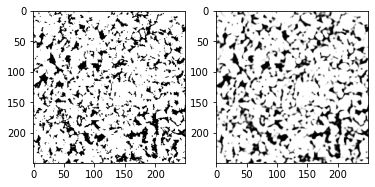

2000it [00:34, 57.80it/s]


Epoch #87: Loss 11368.5830078125, Rec-Loss 10869.0849609375, KL-Loss 499.4820861816406, Test loss 12284.9462890625


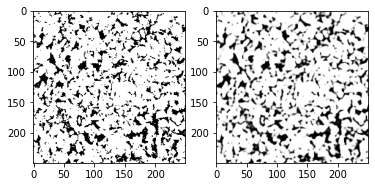

2000it [00:34, 58.08it/s]


Epoch #88: Loss 11345.3037109375, Rec-Loss 10845.5654296875, KL-Loss 499.73828125, Test loss 12268.69140625


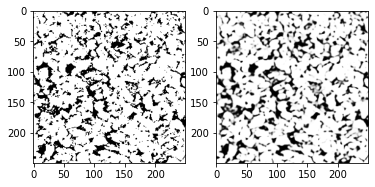

2000it [00:34, 57.94it/s]


Epoch #89: Loss 11320.552734375, Rec-Loss 10820.474609375, KL-Loss 500.0766906738281, Test loss 12240.263671875


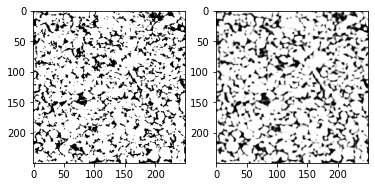

2000it [00:34, 57.99it/s]


Epoch #90: Loss 11296.6015625, Rec-Loss 10796.3173828125, KL-Loss 500.3001708984375, Test loss 12224.8330078125


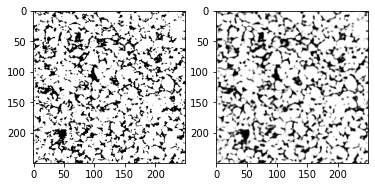

2000it [00:34, 57.85it/s]


Epoch #91: Loss 11275.021484375, Rec-Loss 10774.23046875, KL-Loss 500.79052734375, Test loss 12207.775390625


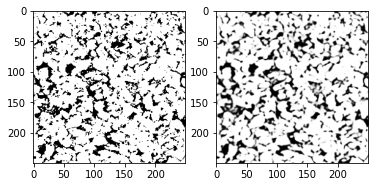

2000it [00:34, 58.05it/s]


Epoch #92: Loss 11251.3251953125, Rec-Loss 10750.37109375, KL-Loss 500.9268798828125, Test loss 12200.787109375


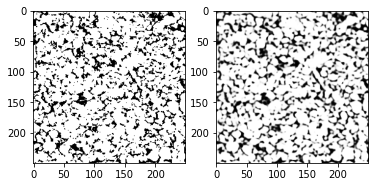

2000it [00:34, 57.79it/s]


Epoch #93: Loss 11229.4384765625, Rec-Loss 10728.185546875, KL-Loss 501.2581481933594, Test loss 12165.9453125


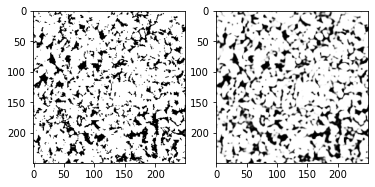

2000it [00:34, 57.95it/s]


Epoch #94: Loss 11207.904296875, Rec-Loss 10706.25390625, KL-Loss 501.6501159667969, Test loss 12150.6611328125


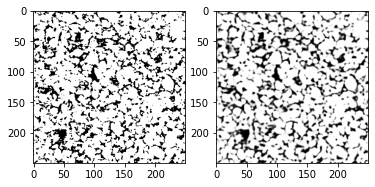

2000it [00:34, 58.08it/s]


Epoch #95: Loss 11185.7080078125, Rec-Loss 10683.78515625, KL-Loss 501.9390563964844, Test loss 12136.5244140625


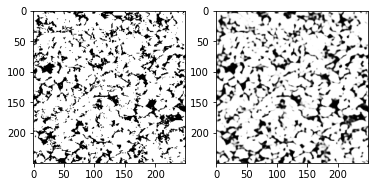

2000it [00:34, 57.90it/s]


Epoch #96: Loss 11165.4990234375, Rec-Loss 10663.27734375, KL-Loss 502.2249755859375, Test loss 12106.7998046875


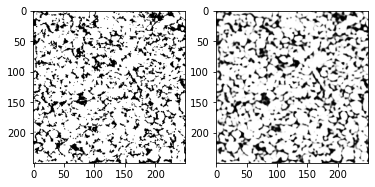

2000it [00:34, 57.96it/s]


Epoch #97: Loss 11142.234375, Rec-Loss 10639.984375, KL-Loss 502.25201416015625, Test loss 12099.59375


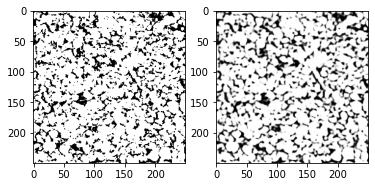

2000it [00:34, 57.99it/s]


Epoch #98: Loss 11121.091796875, Rec-Loss 10618.6396484375, KL-Loss 502.4441833496094, Test loss 12080.4765625


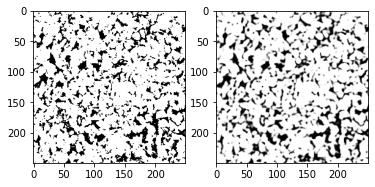

2000it [00:34, 57.83it/s]


Epoch #99: Loss 11103.501953125, Rec-Loss 10600.9462890625, KL-Loss 502.5657958984375, Test loss 12065.396484375


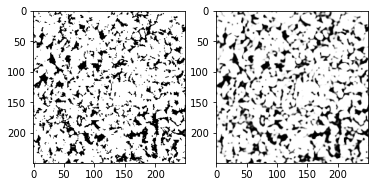

In [ ]:
train(100, 1, 1)

980it [00:10, 91.16it/s] 


Epoch #0: Loss 10436.705078125, Rec-Loss 10003.59375, KL-Loss 433.1106872558594, Test loss 29788.767578125


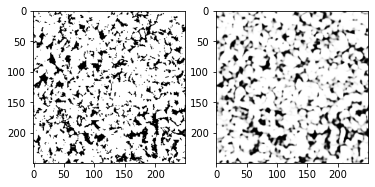

980it [00:10, 91.19it/s] 


Epoch #1: Loss 9987.7568359375, Rec-Loss 9553.4912109375, KL-Loss 434.2705383300781, Test loss 30882.400390625


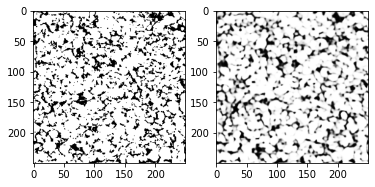

980it [00:10, 91.23it/s] 


Epoch #2: Loss 9657.447265625, Rec-Loss 9223.8271484375, KL-Loss 433.60626220703125, Test loss 31154.234375


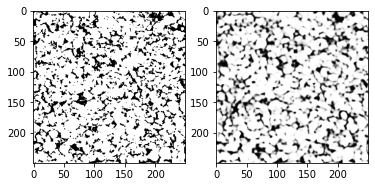

980it [00:10, 93.14it/s] 


Epoch #3: Loss 9378.8017578125, Rec-Loss 8944.015625, KL-Loss 434.7815856933594, Test loss 32226.4765625


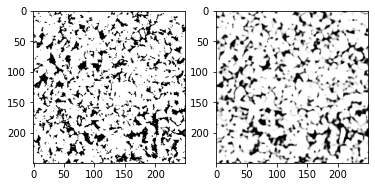

980it [00:10, 92.17it/s] 


Epoch #4: Loss 9148.1611328125, Rec-Loss 8711.74609375, KL-Loss 436.40625, Test loss 32633.310546875


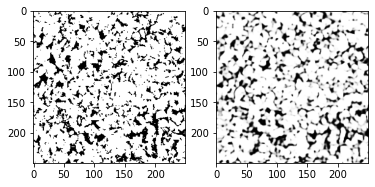

980it [00:10, 93.31it/s] 


Epoch #5: Loss 8960.3125, Rec-Loss 8523.4384765625, KL-Loss 436.867919921875, Test loss 33211.77734375


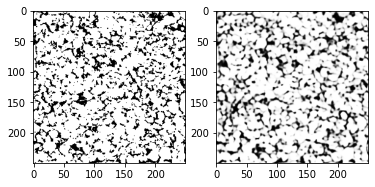

980it [00:10, 93.05it/s] 


Epoch #6: Loss 8785.80859375, Rec-Loss 8347.5185546875, KL-Loss 438.29534912109375, Test loss 33805.17578125


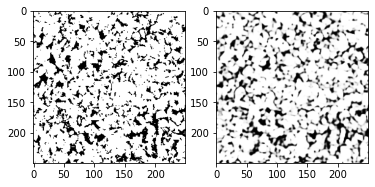

980it [00:10, 93.16it/s] 


Epoch #7: Loss 8654.529296875, Rec-Loss 8214.9052734375, KL-Loss 439.62274169921875, Test loss 34217.0078125


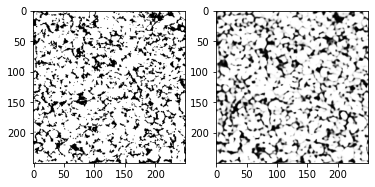

980it [00:10, 92.29it/s] 


Epoch #8: Loss 8514.0068359375, Rec-Loss 8073.81884765625, KL-Loss 440.1906433105469, Test loss 34729.3125


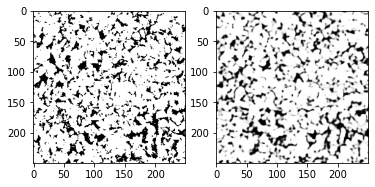

980it [00:10, 93.00it/s] 


Epoch #9: Loss 8409.115234375, Rec-Loss 7967.9052734375, KL-Loss 441.20428466796875, Test loss 35304.88671875


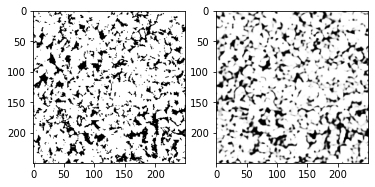

In [ ]:
train(10, 1, 1)

In [ ]:
encoder.load_weights(f'./core_plugs/models_vae_250_tt/encoder_epoch_final_2.ckpt')
decoder.load_weights(f'./core_plugs/models_vae_250_tt/decoder_epoch_final_2.ckpt')

In [ ]:
#encoder.save_weights(f'./core_plugs/models_vae_250_tt/encoder_epoch_final_2.ckpt')
#decoder.save_weights(f'./core_plugs/models_vae_250_tt/decoder_epoch_final_2.ckpt')

In [ ]:
def binary_slice(x):
  x = (x - tf.reduce_min(x)) / (tf.reduce_max(x) - tf.reduce_min(x))
  x = tf.cast(tf.math.greater_equal(x, 0.55), tf.float32)
  return x

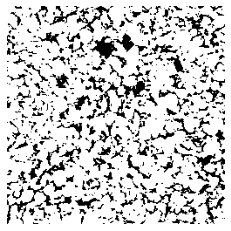

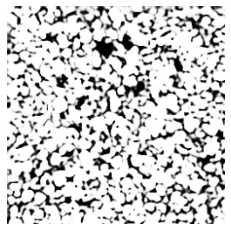

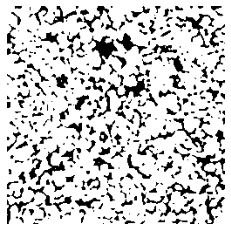

In [ ]:
for x in train_dataset.take(1):
    loss, reconstruction, _, _ = loss_func(x, betta)
    plt.imshow(x[0,:,:,0])
    plt.axis('off')
    plt.show()

    plt.imshow(reconstruction[0,:,:,0])
    plt.axis('off')
    plt.show()

    plt.imshow(binary_slice(reconstruction)[0,:,:,0])
    plt.axis('off')
    plt.show()

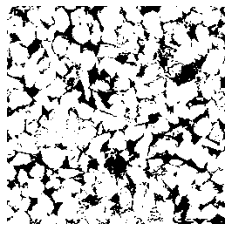

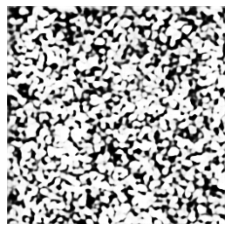

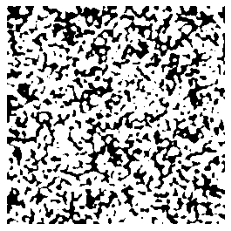

In [ ]:
for x in train_dataset.take(1):
    loss, reconstruction, _, _ = loss_func(x, betta)
    plt.imshow(x[0,:,:,0])
    plt.axis('off')
    plt.show()

    plt.imshow(reconstruction[0,:,:,0])
    plt.axis('off')
    plt.show()

    plt.imshow(binary_slice(reconstruction)[0,:,:,0])
    plt.axis('off')
    plt.show()

In [ ]:
_, _, val_datasets = read_dataset(
    slices_folder,
    slices_type = tf.uint8,
    im_height=im_height,
    im_width=im_width,
    seq_len=seq_len,
    batch_size=batch_size,
    prefetch_num=prefetch_num,
    val_core_list = ['BB_2d25um_binary'],
    #val_core_list = ['Berea_2d25um_binary'],
    window_shift=window_shift,
    window_stride=window_stride)

In [ ]:
latent_enc = []
for k, d in val_datasets.items():
  print(k)
  if k == 'Berea_2d25um_binary' or k == 'BB_2d25um_binary':
    for sl in tqdm(d):
      z_mean, z_log_var, z = encoder(tf.expand_dims(sl,0))
      latent_enc.append(z_mean)
    latent_enc = tf.stack(latent_enc)

BB_2d25um_binary


100%|██████████| 1000/1000 [00:27<00:00, 35.82it/s]


In [ ]:
print(latent_enc)

tf.Tensor(
[[[-0.19512156  0.6641405  -0.7431073  ... -1.7164674  -0.3155793
   -0.8716325 ]]

 [[ 0.08457601  0.7313213  -0.61753565 ... -1.7774825  -0.2589301
   -0.8457278 ]]

 [[-0.20795774  0.6579787  -0.822765   ... -1.616659   -0.34054202
   -0.81246144]]

 ...

 [[-0.1445334   0.40759808  0.02489086 ... -1.3569814   1.3629254
    1.190459  ]]

 [[-0.2567414   0.34708118  0.1655141  ... -1.503673    1.3070827
    0.98538834]]

 [[-0.35004228  0.2998364   0.25256017 ... -1.592001    1.1499645
    0.83282465]]], shape=(1000, 1, 128), dtype=float32)


In [ ]:
print(latent_enc.shape)

(1000, 1, 128)


In [ ]:
latent_enc = tf.squeeze(latent_enc)
print(latent_enc.shape)

(1000, 128)


In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

pca = PCA(n_components=2)
pca.fit(latent_enc)

PCA(copy=True, iterated_power='auto', n_components=2, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [ ]:
pca.explained_variance_ratio_

array([0.05875007, 0.05479345])

In [ ]:
Z_pca = pca.transform(latent_enc)
Z_pca.shape

(1000, 2)

In [ ]:
Z_pca.T.shape

(2, 1000)

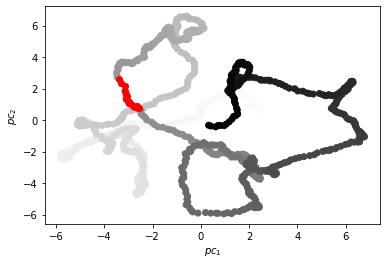

In [ ]:
fig, ax = plt.subplots()

ax.scatter(*Z_pca.T, c=np.arange(0.,1.,1/1000), cmap=plt.get_cmap('Greys'))

ax.set_xlabel('$pc_1$')
ax.set_ylabel('$pc_2$')

ax.scatter(*Z_pca.T[:,from_n:to_n], c='red')

plt.show()

In [ ]:
tsne = TSNE(n_components=2, n_iter=5000)
#tsne.fit(latent_enc)
Z_tsne = tsne.fit_transform(latent_enc)

In [ ]:
np.arange(0.,1.,1/1000).shape

(1000,)

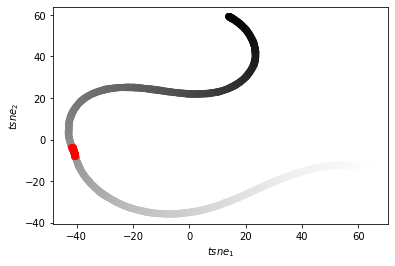

In [ ]:
fig, ax = plt.subplots()

ax.scatter(*Z_tsne.T, c=np.arange(0.,1.,1/1000), cmap=plt.get_cmap('Greys'))

ax.set_xlabel('$tsne_1$')
ax.set_ylabel('$tsne_2$')

ax.scatter(*Z_tsne.T[:,from_n:to_n], c='red')

plt.show()

In [ ]:
from scipy.interpolate import interp1d, Akima1DInterpolator, CubicSpline, PchipInterpolator, CubicHermiteSpline
# f = interp1d(
#     np.concatenate([np.arange(from_n), np.arange(to_n,1000)]), 
#     np.concatenate([latent_enc[:from_n,:], latent_enc[to_n:,:]], 0),
#     kind='cubic', axis=0)
f = Akima1DInterpolator(
  np.concatenate([np.arange(from_n), np.arange(to_n,1000)]), 
  np.concatenate([latent_enc[:from_n,:], latent_enc[to_n:,:]], 0),
  axis=0)
# f = Akima1DInterpolator(
#   np.arange(1000), 
#   latent_enc,
#   axis=0)

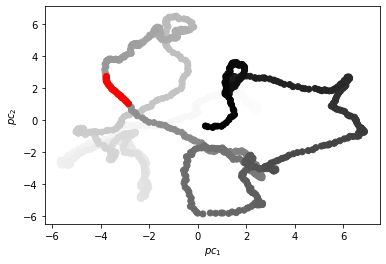

In [ ]:
aprox_latent = f(np.arange(1000))

pca_intr = PCA(n_components=2)
pca_intr.fit(aprox_latent)
Z_pca_intr = pca_intr.transform(aprox_latent)

fig, ax = plt.subplots()

ax.scatter(*Z_pca_intr.T, c=np.arange(0.,1.,1/1000), cmap=plt.get_cmap('Greys'))

ax.set_xlabel('$pc_1$')
ax.set_ylabel('$pc_2$')

ax.scatter(*Z_pca_intr.T[:,from_n:to_n], c='red')

plt.show()

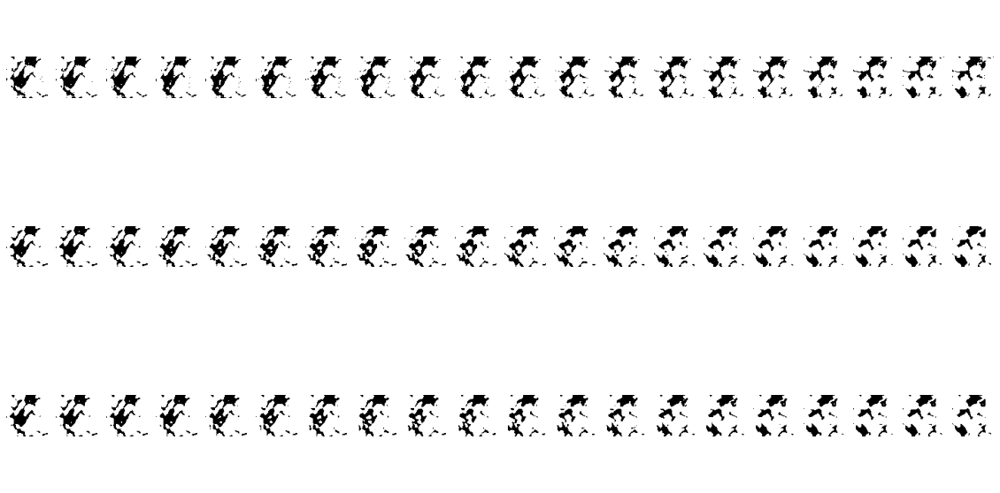

0.63805544 0.1545368


In [ ]:
l_range = np.arange(from_n,to_n)

m = tf.keras.metrics.MeanIoU(num_classes=2)
m_mse = tf.keras.metrics.MeanSquaredError()

#gt_data = list(val_datasets['Berea_2d25um_binary'].as_numpy_iterator())
gt_data = list(val_datasets['BB_2d25um_binary'].as_numpy_iterator())

break_p = 20

k = 1
f_slice = None
dif_slice = None
dif_slice_warp = None
fig = plt.figure(figsize=(20,10))
for l in l_range:
  intrp_latent = f(l)

  pred_intrp_sl = binary_slice(decoder(tf.expand_dims(intrp_latent,0)))
  # pred_intrp_sl = (pred_intrp_sl - tf.reduce_min(pred_intrp_sl)) / (tf.reduce_max(pred_intrp_sl) - tf.reduce_min(pred_intrp_sl))
  # pred_intrp_sl = tf.cast(tf.math.greater_equal(pred_intrp_sl, 0.55), tf.float32)
  pred_vae_sl = binary_slice(decoder(tf.expand_dims(latent_enc[l],0)))
  gt_sl = gt_data[l]

  if k == 1:
    f_slice = gt_sl

  plt.axis('off')
  fig.add_subplot(3,break_p,k)
  plt.imshow(gt_sl[170:230,120:180,0])

  plt.axis('off')
  fig.add_subplot(3,break_p,break_p+k)
  plt.imshow(pred_vae_sl[0,170:230,120:180,0])

  plt.axis('off')
  fig.add_subplot(3,break_p,2*break_p+k)
  plt.imshow(pred_intrp_sl[0,170:230,120:180,0])

  plt.axis('off')

  if k==9:
    dif_slice = gt_sl
    dif_slice_warp = pred_intrp_sl

  k += 1

  #170:230,120:180

  #print(loss_func(tf.expand_dims(gt_data[l], 0), 1)[2])
  
  m.update_state(gt_sl, f_slice)
  m_mse.update_state(gt_sl, f_slice)

  if k == break_p + 1:
    break

  #pred_sl = tf.cast(tf.math.greater_equal(pred_sl, 0.6), tf.float32)
    
plt.show()

print(m.result().numpy(), m_mse.result().numpy())

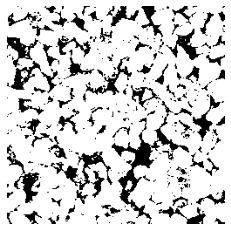

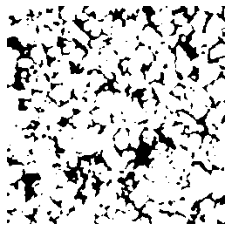

0.6546353 0.144752
tf.Tensor(0.203152, shape=(), dtype=float32) tf.Tensor(0.204512, shape=(), dtype=float32) tf.Tensor(0.20558399, shape=(), dtype=float32)


In [ ]:
m = tf.keras.metrics.MeanIoU(num_classes=2)
m_mse = tf.keras.metrics.MeanSquaredError()

plt.axis('off')
plt.imshow(dif_slice[:,:,0])
plt.show()

plt.axis('off')
plt.imshow(dif_slice_warp[0,:,:,0])
plt.show()

m.update_state(dif_slice, dif_slice_warp[0])
m_mse.update_state(dif_slice, dif_slice_warp[0])
print(m.result().numpy(), m_mse.result().numpy())
print(1 - tf.reduce_mean(dif_slice), 1 - tf.reduce_mean(dif_slice_warp[0]), 1 - tf.reduce_mean(f_slice))

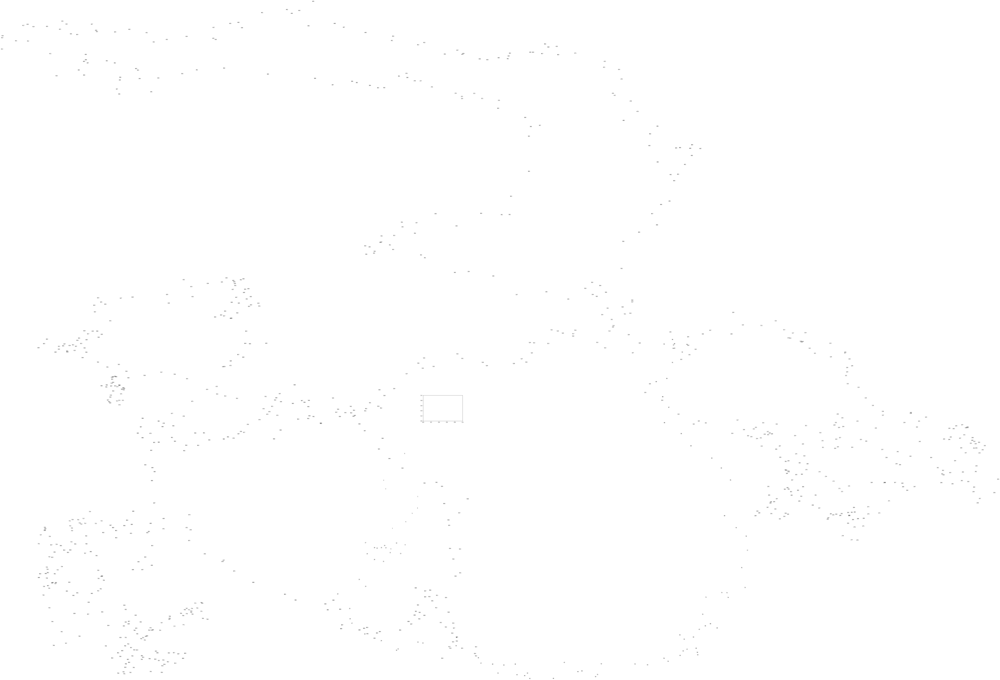

In [ ]:
# for i in range(1000):
  plt.text(Z_pca[i,0],  Z_pca[i,1], str(i))
plt.show()

<Figure size 432x288 with 0 Axes>

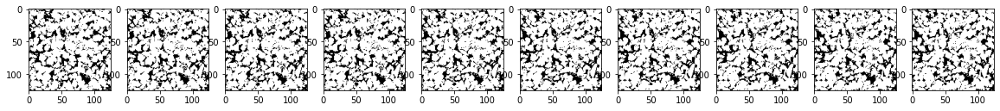

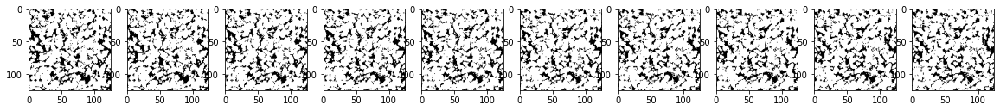

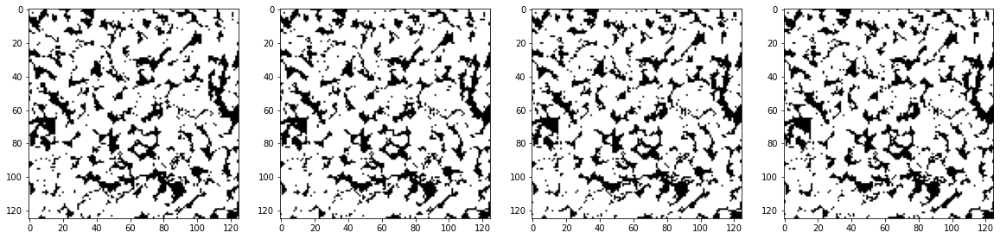

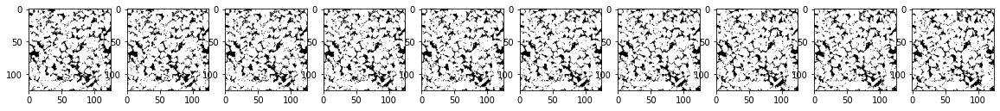

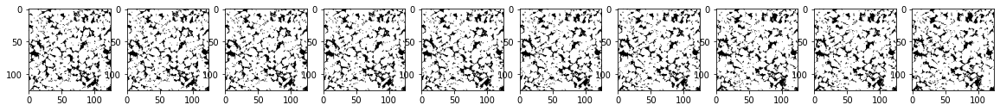

In [ ]:
plt.gray()

td_np = list(val_datasets['BB_2d25um_binary'].as_numpy_iterator())

fig = plt.figure(figsize=(20,20))
for i in range(10):
  fig.add_subplot(1,10,i+1)
  plt.imshow(td_np[317+i][:,:,0])
plt.show()
fig = plt.figure(figsize=(20,20))
for i in range(10):
  fig.add_subplot(1,10,i+1)
  plt.imshow(td_np[327+i][:,:,0])
plt.show()

fig = plt.figure(figsize=(20,20))
for i in range(4):
  fig.add_subplot(1,4,i+1)
  plt.imshow(td_np[337+i][:,:,0])
plt.show()

fig = plt.figure(figsize=(20,20))
for i in range(10):
  fig.add_subplot(1,10,i+1)
  plt.imshow(td_np[347+i][:,:,0])
plt.show()
fig = plt.figure(figsize=(20,20))
for i in range(10):
  fig.add_subplot(1,10,i+1)
  plt.imshow(td_np[357+i][:,:,0])
plt.show()

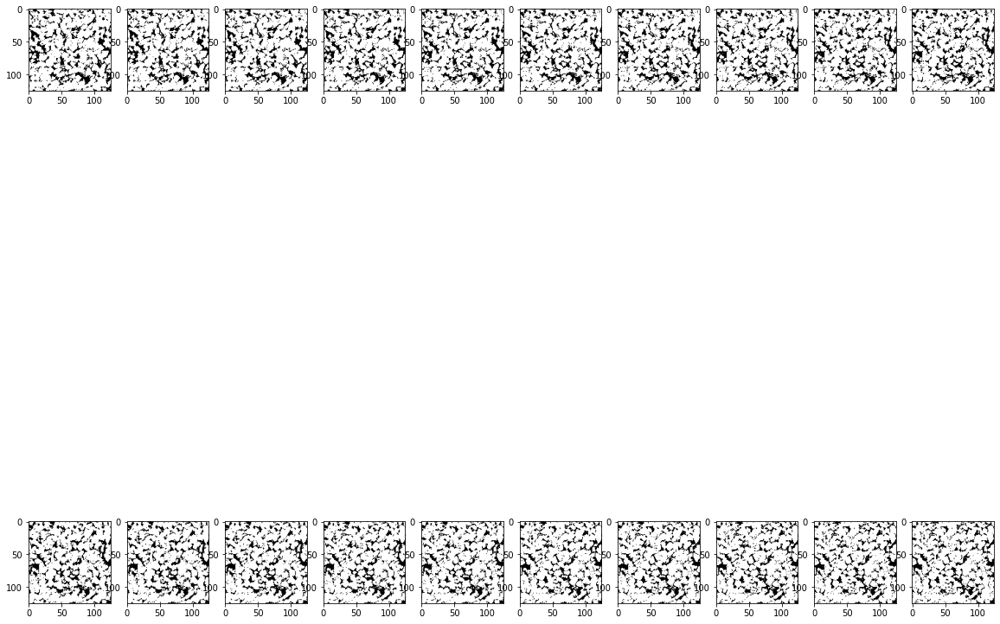

In [ ]:
fig = plt.figure(figsize=(20,20))
for i in range(20):
  fig.add_subplot(2,10,i+1)
  plt.imshow(td_np[330+i][:,:,0])
plt.show()

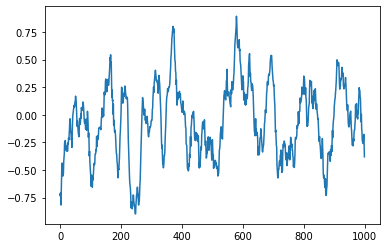

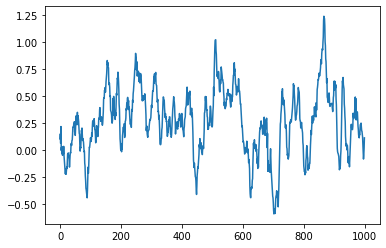

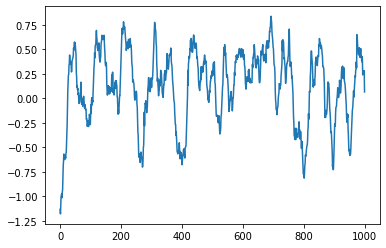

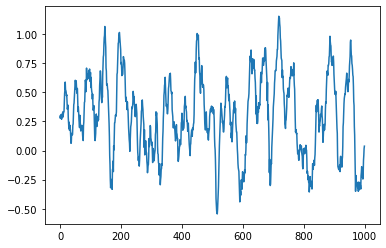

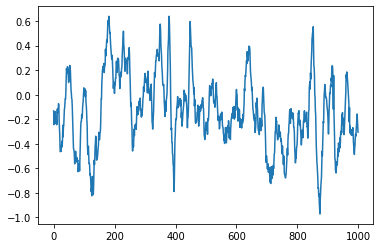

...

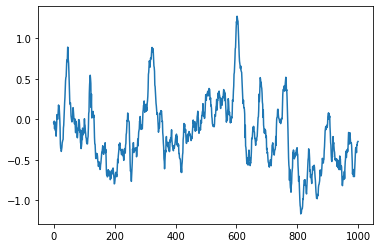

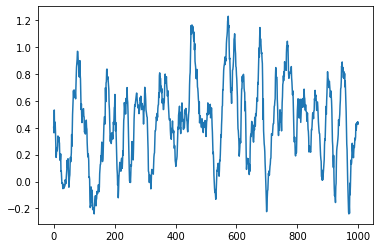

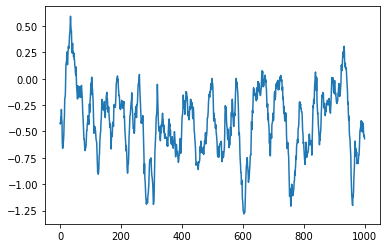

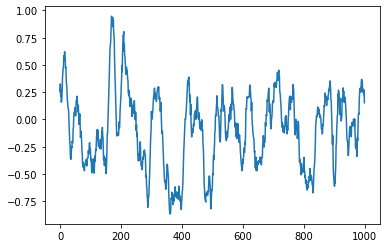

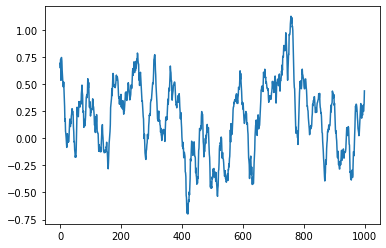

In [ ]:
for i in range(latent_enc.shape[1]):
  plt.plot(latent_enc[:,i])
  plt.show()
  #print(latent_enc[:,i])


BB_2d25um_binary
BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

BB_2d25um_binary


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently re

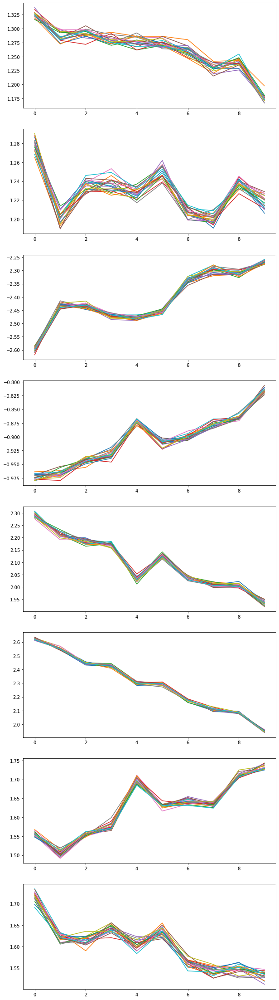

In [ ]:
fig = plt.figure(figsize=(10,40))
for smpl_n in range(20):
  for k, d in val_datasets.items():
    latent_enc_smpl = []
    print(k)
    for sl in d:
      z_mean, z_log_var, z = encoder(tf.expand_dims(sl,0))
      latent_enc_smpl.append(z)
    latent_enc_smpl = tf.stack(latent_enc_smpl)
    latent_enc_smpl = tf.squeeze(latent_enc_smpl)[310:320,:]
    for i in range(latent_enc_smpl.shape[1]):
      fig.add_subplot(latent_enc_smpl.shape[1],1,i+1)
      plt.plot(latent_enc_smpl[:,i])
plt.show()

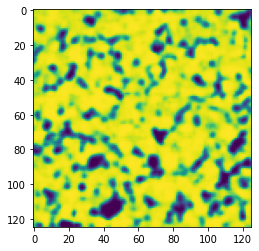

In [ ]:
 plt.imshow(decoder(latent_enc[20:21,:])[0,:,:,0])
plt.show()

In [ ]:
refinement_inputs = keras.Input(shape=input_shape)
x = layers.Conv2D(32, 3, activation="relu", padding="same")(refinement_inputs)
x = layers.Conv2D(64, 3, activation="relu", padding="same")(x)
x = layers.Conv2D(64, 3, activation="relu", padding="same")(x)
x = layers.Conv2D(64, 3, activation="relu", padding="same")(x)
x = layers.Conv2D(1, 3, activation="sigmoid", padding="same")(x)
refinement_net = keras.Model(refinement_inputs, x, name="refinement_net")
refinement_net.summary()

Model: "refinement_net"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 125, 125, 1)]     0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 125, 125, 32)      320       
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 125, 125, 64)      18496     
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 125, 125, 64)      36928     
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 125, 125, 64)      36928     
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 125, 125, 1)       577       
Total params: 93,249
Trainable params: 93,249
Non-trainable params: 0
________________________________________________

In [ ]:
@tf.function
def loss_func_refine(x):
  #return tf.reduce_mean(tf.square(t-p))
  _, _, z = encoder(x)
  reconstruction = decoder(z)
  refined = refinement_net(reconstruction)
  # reconstruction_loss = tf.reduce_mean(
  #     tf.reduce_sum(
  #         keras.losses.binary_crossentropy(x, refined), axis=(1, 2)
  #     )
  # )
  reconstruction_loss = tf.reduce_mean(tf.square(x-refined))
  total_loss = reconstruction_loss
  return total_loss, refined

refine_mean_loss_train = tf.keras.metrics.Mean()
refine_mean_loss_test = tf.keras.metrics.Mean()

refine_optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)

@tf.function
def refine_training_step(x):
    with tf.GradientTape() as tape:
        loss, _ = loss_func_refine(x)
    grads = tape.gradient(loss, refinement_net.trainable_variables)
    refine_optimizer.apply_gradients(zip(grads, refinement_net.trainable_variables))
    refine_mean_loss_train(loss)

2000it [00:16, 122.28it/s]


Epoch #0: Loss 0.13313372433185577, Test loss 0.13383547961711884


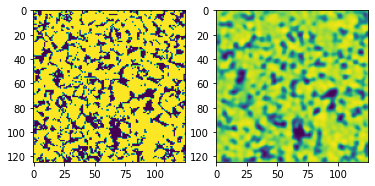

2000it [00:15, 125.15it/s]


Epoch #1: Loss 0.13024383783340454, Test loss 0.1335996687412262


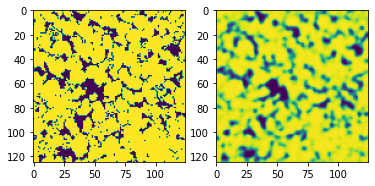

2000it [00:20, 97.52it/s] 


Epoch #2: Loss 0.13015031814575195, Test loss 0.133539617061615


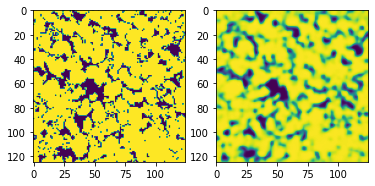

2000it [00:20, 97.51it/s] 


Epoch #3: Loss 0.13009688258171082, Test loss 0.13344085216522217


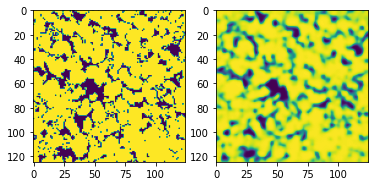

2000it [00:16, 123.85it/s]


Epoch #4: Loss 0.13006405532360077, Test loss 0.1334427446126938


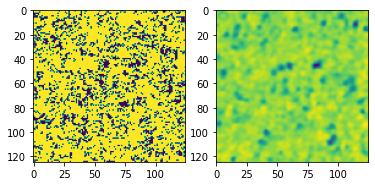

2000it [00:15, 127.16it/s]


Epoch #5: Loss 0.13004539906978607, Test loss 0.13342252373695374


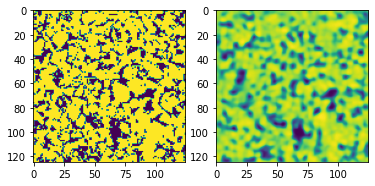

2000it [00:15, 125.45it/s]


Epoch #6: Loss 0.1300179660320282, Test loss 0.1334443986415863


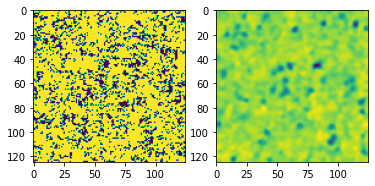

2000it [00:16, 122.96it/s]


Epoch #7: Loss 0.1300113946199417, Test loss 0.13340649008750916


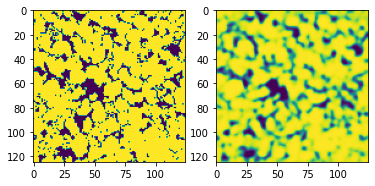

2000it [00:15, 126.04it/s]


Epoch #8: Loss 0.13000363111495972, Test loss 0.13339872658252716


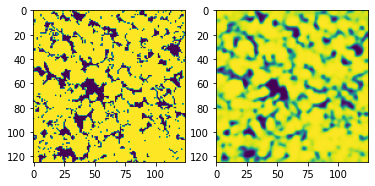

2000it [00:15, 125.41it/s]


Epoch #9: Loss 0.12998135387897491, Test loss 0.13337813317775726


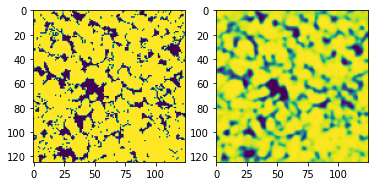

2000it [00:16, 121.22it/s]


Epoch #10: Loss 0.12997649610042572, Test loss 0.1334260255098343


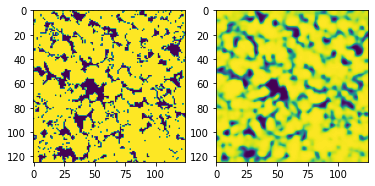

2000it [00:20, 97.49it/s] 


Epoch #11: Loss 0.12996697425842285, Test loss 0.13339298963546753


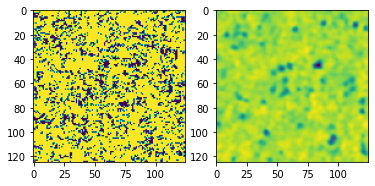

2000it [00:20, 97.50it/s] 


Epoch #12: Loss 0.1299625039100647, Test loss 0.13344630599021912


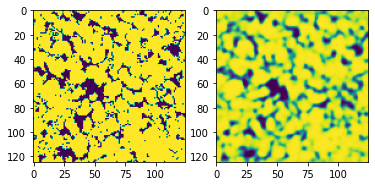

2000it [00:16, 122.80it/s]


Epoch #13: Loss 0.12994424998760223, Test loss 0.13338956236839294


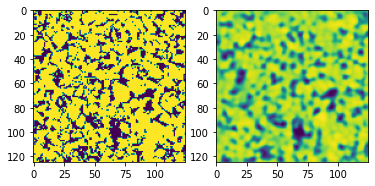

2000it [00:16, 120.60it/s]


Epoch #14: Loss 0.1299406737089157, Test loss 0.13337932527065277


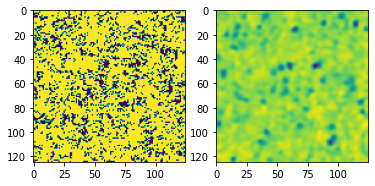

2000it [00:16, 119.09it/s]


Epoch #15: Loss 0.12993307411670685, Test loss 0.13336767256259918


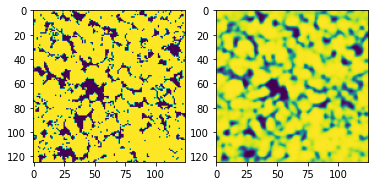

2000it [00:16, 122.51it/s]


Epoch #16: Loss 0.12992599606513977, Test loss 0.13330669701099396


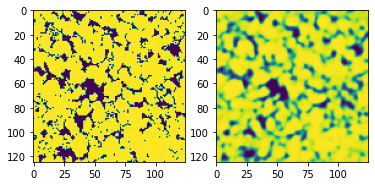

2000it [00:16, 120.27it/s]


Epoch #17: Loss 0.12993349134922028, Test loss 0.1333104968070984


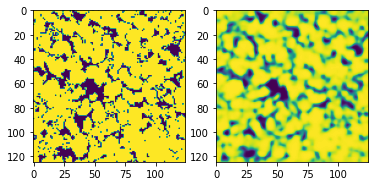

2000it [00:20, 97.51it/s] 


Epoch #18: Loss 0.12991756200790405, Test loss 0.13329552114009857


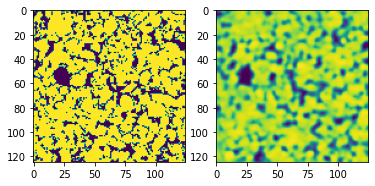

2000it [00:16, 121.98it/s]


Epoch #19: Loss 0.12991099059581757, Test loss 0.13336874544620514


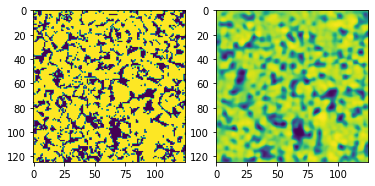

2000it [00:16, 121.32it/s]


Epoch #20: Loss 0.12989987432956696, Test loss 0.13335111737251282


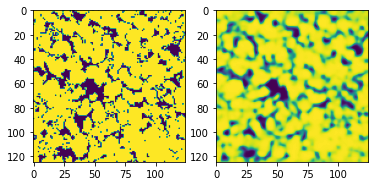

2000it [00:20, 97.50it/s] 


Epoch #21: Loss 0.129898801445961, Test loss 0.13335002958774567


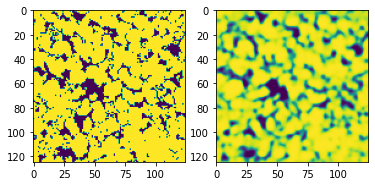

2000it [00:16, 122.13it/s]


Epoch #22: Loss 0.1298937350511551, Test loss 0.1332748681306839


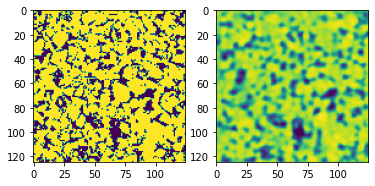

2000it [00:20, 97.47it/s] 


Epoch #23: Loss 0.12987414002418518, Test loss 0.13327665627002716


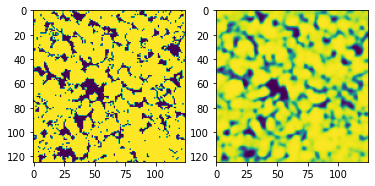

2000it [00:16, 118.40it/s]


Epoch #24: Loss 0.12987639009952545, Test loss 0.13335227966308594


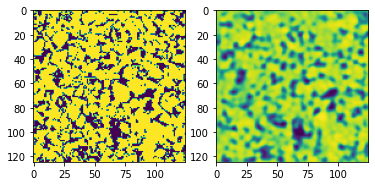

2000it [00:16, 121.21it/s]


Epoch #25: Loss 0.129876971244812, Test loss 0.13327470421791077


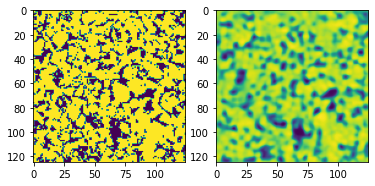

2000it [00:16, 119.67it/s]


Epoch #26: Loss 0.12986867129802704, Test loss 0.1333136260509491


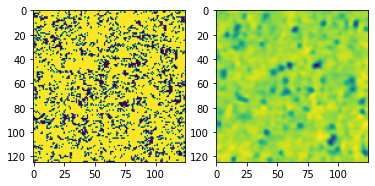

2000it [00:17, 117.44it/s]


Epoch #27: Loss 0.12986400723457336, Test loss 0.133401021361351


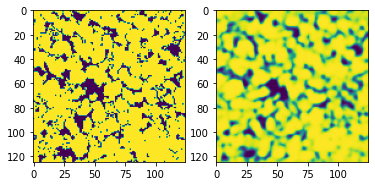

2000it [00:17, 117.38it/s]


Epoch #28: Loss 0.12985393404960632, Test loss 0.13331125676631927


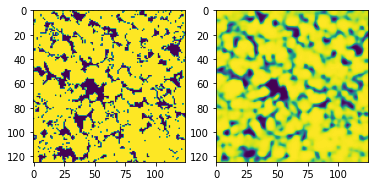

2000it [00:16, 118.73it/s]


Epoch #29: Loss 0.12985318899154663, Test loss 0.13331185281276703


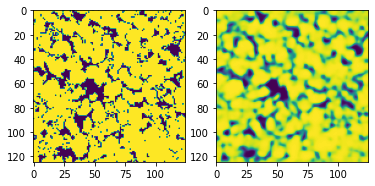

2000it [00:16, 119.77it/s]


Epoch #30: Loss 0.1298363208770752, Test loss 0.13326352834701538


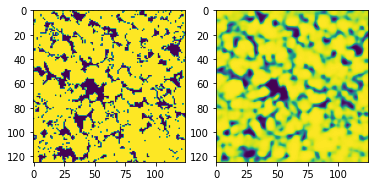

2000it [00:16, 119.06it/s]


Epoch #31: Loss 0.1298404484987259, Test loss 0.1332741230726242


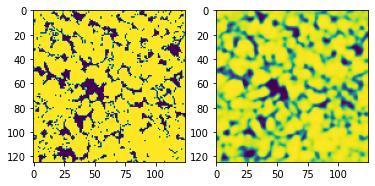

2000it [00:16, 118.51it/s]


Epoch #32: Loss 0.12983618676662445, Test loss 0.13328388333320618


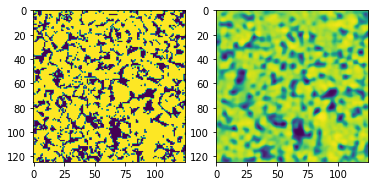

2000it [00:16, 121.64it/s]


Epoch #33: Loss 0.12982890009880066, Test loss 0.13327500224113464


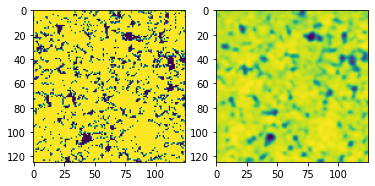

2000it [00:16, 120.22it/s]


Epoch #34: Loss 0.12982311844825745, Test loss 0.13323882222175598


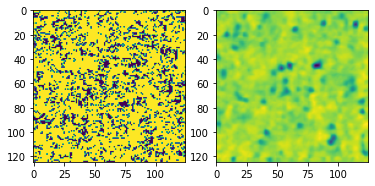

2000it [00:20, 97.50it/s] 


Epoch #35: Loss 0.12982015311717987, Test loss 0.13323336839675903


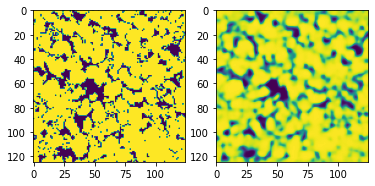

2000it [00:16, 121.22it/s]


Epoch #36: Loss 0.129814013838768, Test loss 0.1332392543554306


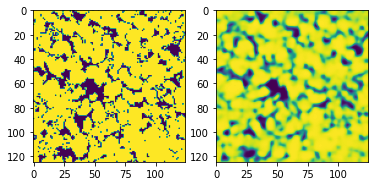

2000it [00:16, 120.26it/s]


Epoch #37: Loss 0.12980541586875916, Test loss 0.13325904309749603


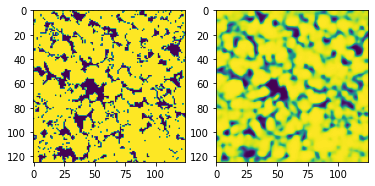

2000it [00:17, 115.59it/s]


Epoch #38: Loss 0.12979654967784882, Test loss 0.13323840498924255


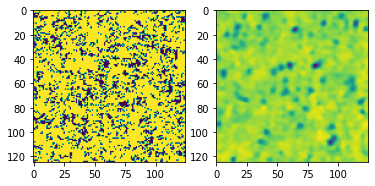

2000it [00:16, 120.32it/s]


Epoch #39: Loss 0.12978900969028473, Test loss 0.13321860134601593


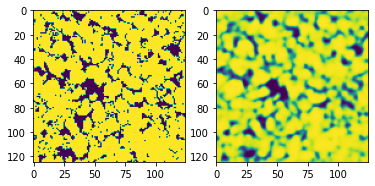

2000it [00:20, 97.50it/s] 


Epoch #40: Loss 0.12978923320770264, Test loss 0.13321688771247864


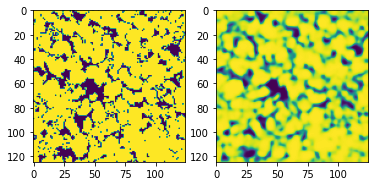

2000it [00:17, 116.07it/s]


Epoch #41: Loss 0.12978582084178925, Test loss 0.13329625129699707


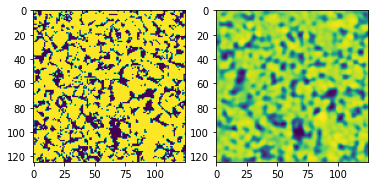

2000it [00:17, 116.86it/s]


Epoch #42: Loss 0.1297793686389923, Test loss 0.1332564502954483


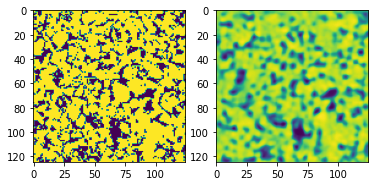

2000it [00:20, 97.46it/s] 


Epoch #43: Loss 0.1297677606344223, Test loss 0.1332126408815384


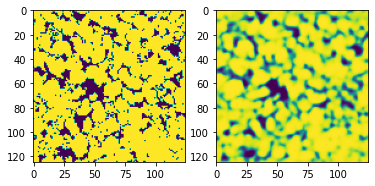

2000it [00:16, 119.45it/s]


Epoch #44: Loss 0.1297658383846283, Test loss 0.13339224457740784


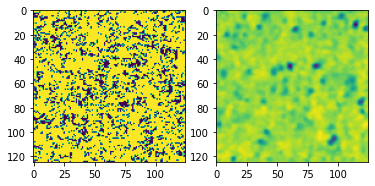

1742it [00:14, 114.91it/s]

KeyboardInterrupt: ignored

In [ ]:
for epoch in range(num_epochs):
    for x in tqdm(train_dataset):
        refine_training_step(x)
        
    train_x = x
        
    for x in test_dataset:
        loss, refined = loss_func_refine(x)
        refine_mean_loss_test(loss)
        
    print(f'Epoch #{epoch}: Loss {refine_mean_loss_train.result()}, Test loss {refine_mean_loss_test.result()}')
    
    fig = plt.figure()
    
    fig.add_subplot(1,2,1)
    plt.imshow(x[0,:,:,0])
    fig.add_subplot(1,2,2)
    plt.imshow(refined[0,:,:,0])
    plt.show()
    
    refine_mean_loss_train.reset_states()
    refine_mean_loss_test.reset_states()

    if epoch % 1 == 0:
      refinement_net.save_weights(f'./core_plugs/models_vae/refinement_net_mse_epoch_{epoch}.ckpt')

BB_2d25um_binary


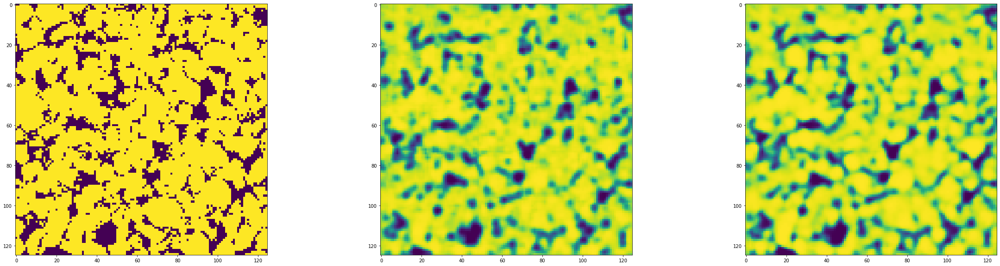

In [ ]:
# bce loss trained
for k, d in val_datasets.items():
  print(k)
  for sl in d.take(1):
    sl = tf.expand_dims(sl,0)
    z_mean, z_log_var, z = encoder(sl)
    decoded = decoder(z)
    refined = refinement_net(decoded)
    fig = plt.figure(figsize=(40,10))
    
    fig.add_subplot(1,3,1)
    plt.imshow(sl[0,:,:,0])
    fig.add_subplot(1,3,2)
    plt.imshow(decoded[0,:,:,0])
    fig.add_subplot(1,3,3)
    plt.imshow(refined[0,:,:,0])
    plt.show()

In [ ]:
# mse loss trained
for k, d in val_datasets.items():
  print(k)
  for sl in d.take(1):
    sl = tf.expand_dims(sl,0)
    z_mean, z_log_var, z = encoder(sl)
    decoded = decoder(z)
    refined = refinement_net(decoded)
    fig = plt.figure(figsize=(40,10))
    
    fig.add_subplot(1,3,1)
    plt.imshow(sl[0,:,:,0])
    fig.add_subplot(1,3,2)
    plt.imshow(decoded[0,:,:,0])
    fig.add_subplot(1,3,3)
    plt.imshow(refined[0,:,:,0])
    plt.show()

In [ ]:
core_porosity = []
for k, d in val_datasets.items():
  print(k)
  if k == 'Berea_2d25um_binary':
    for sl in d:
      core_porosity.append(1 - tf.reduce_mean(sl))
    core_porosity = tf.stack(core_porosity)

Berea_2d25um_binary


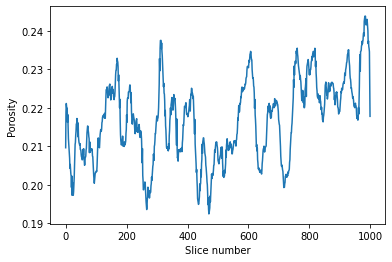

In [ ]:
plt.plot(core_porosity)
plt.xlabel('Slice number')
plt.ylabel('Porosity')
plt.show()

0.4865116477012634


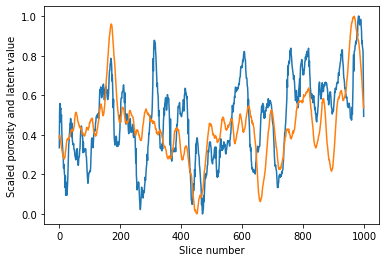

0.6065613031387329


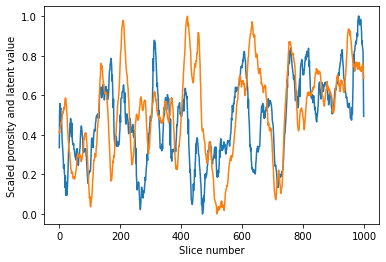

0.6145342290401459


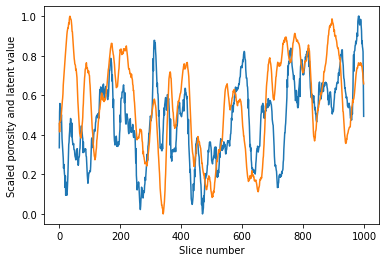

0.6352295279502869


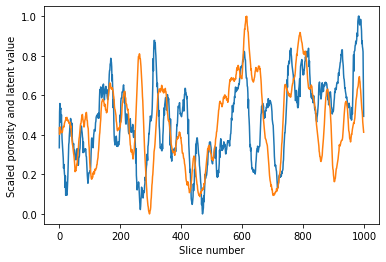

0.6455635726451874


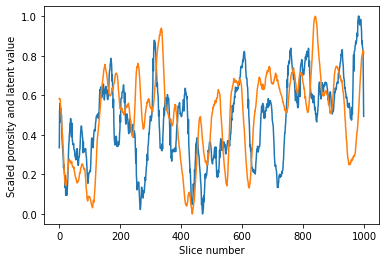

In [ ]:
import scipy
from scipy.spatial.distance import correlation

latent_porosity = []

for i in range(latent_dim):
  scaled_latent_enc = latent_enc[:,i]
  scaled_latent_enc = (scaled_latent_enc - tf.reduce_min(scaled_latent_enc))/(tf.reduce_max(scaled_latent_enc)-tf.reduce_min(scaled_latent_enc))

  scaled_core_porosity = core_porosity
  scaled_core_porosity = (scaled_core_porosity - tf.reduce_min(scaled_core_porosity))/(tf.reduce_max(scaled_core_porosity)-tf.reduce_min(scaled_core_porosity))
  #print(tf.reduce_mean(tf.square(scaled_core_porosity -  scaled_latent_enc)))

  latent_porosity.append({
      'latent': scaled_latent_enc,
      'porosity': scaled_core_porosity,
      'corr': scipy.spatial.distance.correlation(scaled_core_porosity, scaled_latent_enc)
  })

latent_porosity.sort(key=lambda lp: lp['corr'])

for i in range(5):
  print(latent_porosity[i]['corr'])
  plt.plot(latent_porosity[i]['porosity'])
  plt.plot(latent_porosity[i]['latent'])
  plt.xlabel('Slice number')
  plt.ylabel('Scaled porosity and latent value')
  plt.show()

AE results


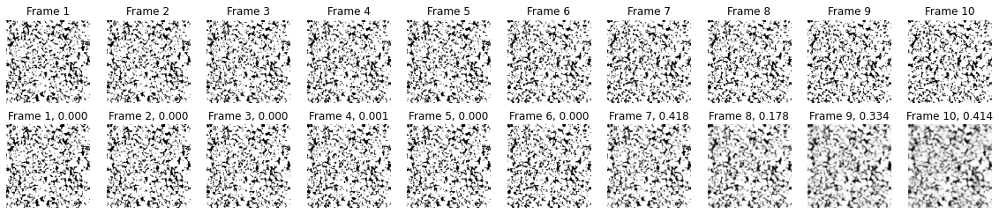

FP results


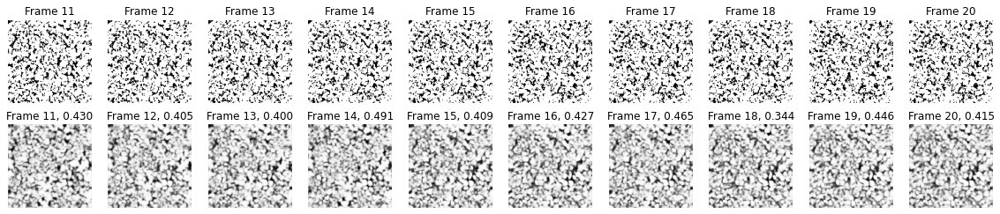

In [ ]:
for k, d in val_datasets.items():
  d_windowed = d \
    .window(20, shift=1, drop_remainder=True) \
    .flat_map(lambda window: window.batch(20)).batch(1)
  for w in d_windowed.skip(40).take(1):
    rx = w[:,:10,...]
    ry = w[:,10:,...]
    x_ae, y_fp = model(rx)
    print('AE results')
    # Construct a figure for the original and new frames.
    fig, axes = plt.subplots(2, 10, figsize=(20, 4))

    # Plot the original frames.
    for idx, ax in enumerate(axes[0]):
        ax.imshow(np.squeeze(rx[0,idx,...]), cmap="gray")
        ax.set_title(f"Frame {idx + 1}")
        ax.axis("off")

    # Plot the new frames.
    x_ae = tf.reverse(x_ae,[1]).numpy()
    for idx, ax in enumerate(axes[1]):
        pred_f = np.squeeze(x_ae[0,idx,...])
        gt_f = np.squeeze(rx[0,idx,...])
        ax.imshow(pred_f, cmap="gray")
        ce_err = "{:.3f}".format(loss_func(gt_f,pred_f))
        ax.set_title(f"Frame {idx + 1}, {ce_err}")
        ax.axis("off")
    plt.show()

    print('FP results')

    fig, axes = plt.subplots(2, 10, figsize=(20, 4))

    # Plot the original frames.
    for idx, ax in enumerate(axes[0]):
        ax.imshow(np.squeeze(ry[0,idx,...]), cmap="gray")
        ax.set_title(f"Frame {idx + 11}")
        ax.axis("off")

    # Plot the new frames.
    y_fp = y_fp.numpy()
    for idx, ax in enumerate(axes[1]):
        pred_f = np.squeeze(y_fp[0,idx,...])
        gt_f = np.squeeze(ry[0,idx,...])
        ax.imshow(pred_f, cmap="gray")
        ce_err = "{:.3f}".format(loss_func(gt_f,pred_f))
        ax.set_title(f"Frame {idx + 11}, {ce_err}")
        ax.axis("off")
    plt.show()

FP results


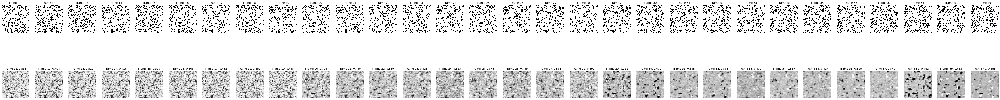

In [ ]:
for k, d in val_datasets.items():
  d_windowed = d \
    .window(40, shift=1, drop_remainder=True) \
    .flat_map(lambda window: window.batch(40)).batch(1)
  for w in d_windowed.skip(0).take(1):
    rx = w[:,:10,...]
    ry = w[:,10:,...]

    print('FP results')

    fig, axes = plt.subplots(2, 30, figsize=(80, 10))

    # Plot the original frames.
    for idx, ax in enumerate(axes[0]):
        ax.imshow(np.squeeze(ry[0,idx,...]), cmap="gray")
        ax.set_title(f"Frame {idx + 11}")
        ax.axis("off")

    # Plot the new frames.
    for idx, ax in enumerate(axes[1]):
        x_ae, y_fp = model(rx)
        pred_f = np.squeeze(y_fp.numpy()[0,0,...])
        gt_f = np.squeeze(ry[0,idx,...])
        ax.imshow(pred_f, cmap="gray")
        ce_err = "{:.3f}".format(loss_func(gt_f,pred_f))
        ax.set_title(f"Frame {idx + 11}, {ce_err}")
        ax.axis("off")
        rx = tf.concat([rx[:,1:,...], y_fp[:,0:1,...]], 1)
    plt.show()

FP results


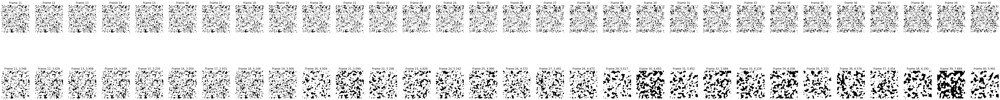

In [ ]:
for k, d in val_datasets.items():
  d_windowed = d \
    .window(40, shift=1, drop_remainder=True) \
    .flat_map(lambda window: window.batch(40)).batch(1)
  for w in d_windowed.skip(0).take(1):
    rx = w[:,:10,...]
    ry = w[:,10:,...]

    print('FP results')

    fig, axes = plt.subplots(2, 30, figsize=(80, 10))

    # Plot the original frames.
    for idx, ax in enumerate(axes[0]):
        ax.imshow(np.squeeze(ry[0,idx,...]), cmap="gray")
        ax.set_title(f"Frame {idx + 11}")
        ax.axis("off")

    # Plot the new frames.
    for idx, ax in enumerate(axes[1]):
        x_ae, y_fp = model(rx)
        pred_f = y_fp[:,0:1,...]
        pred_slice_min = tf.reduce_min(pred_f)
        pred_slice_max = tf.reduce_max(pred_f)
        pred_slice = (pred_f - pred_slice_min)/(pred_slice_max-pred_slice_min)
        pred_slice = tf.cast(tf.math.greater(pred_slice, 0.6), tf.float32)

        pred_f = np.squeeze(pred_slice.numpy()[0])
        gt_f = np.squeeze(ry[0,idx,...])
        ax.imshow(pred_f, cmap="gray")
        ce_err = "{:.3f}".format(loss_func(gt_f,pred_f))
        ax.set_title(f"Frame {idx + 11}, {ce_err}")
        ax.axis("off")
        rx = tf.concat([rx[:,1:,...], pred_slice], 1)
    plt.show()

FP results


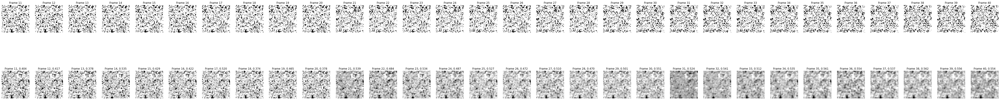

In [ ]:
for k, d in val_datasets.items():
  d_windowed = d \
    .window(40, shift=1, drop_remainder=True) \
    .flat_map(lambda window: window.batch(40)).batch(1)
  for w in d_windowed.skip(0).take(1):
    rx = w[:,:10,...]
    ry = w[:,10:,...]

    print('FP results')

    fig, axes = plt.subplots(2, 30, figsize=(80, 10))

    # Plot the original frames.
    for idx, ax in enumerate(axes[0]):
        ax.imshow(np.squeeze(ry[0,idx,...]), cmap="gray")
        ax.set_title(f"Frame {idx + 11}")
        ax.axis("off")
    
    _, y_fp = model(rx)
    g_y_fp = y_fp

    for i in range(2):
      _, y_fp = model(y_fp)
      g_y_fp = tf.concat([g_y_fp, y_fp], 1)

    # Plot the new frames.
    for idx, ax in enumerate(axes[1]):
        pred_f = np.squeeze(g_y_fp.numpy()[0,idx,...])
        gt_f = np.squeeze(ry[0,idx,...])
        ax.imshow(pred_f, cmap="gray")
        ce_err = "{:.3f}".format(loss_func(gt_f,pred_f))
        ax.set_title(f"Frame {idx + 11}, {ce_err}")
        ax.axis("off")
        rx = y_fp
    plt.show()

FP results


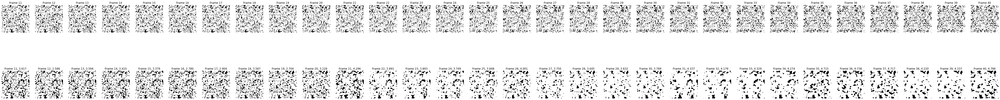

In [ ]:
for k, d in val_datasets.items():
  d_windowed = d \
    .window(40, shift=1, drop_remainder=True) \
    .flat_map(lambda window: window.batch(40)).batch(1)
  for w in d_windowed.skip(0).take(1):
    rx = w[:,:10,...]
    ry = w[:,10:,...]

    print('FP results')

    fig, axes = plt.subplots(2, 30, figsize=(80, 10))

    # Plot the original frames.
    for idx, ax in enumerate(axes[0]):
        ax.imshow(np.squeeze(ry[0,idx,...]), cmap="gray")
        ax.set_title(f"Frame {idx + 11}")
        ax.axis("off")

    _, y_fp = model(rx)
    g_y_fp = y_fp

    for i in range(2):
      _, y_fp = model(y_fp)
      g_y_fp = tf.concat([g_y_fp, y_fp], 1)

    # Plot the new frames.
    for idx, ax in enumerate(axes[1]):
        pred_f = g_y_fp[:,idx,...]
        pred_slice_min = tf.reduce_min(pred_f)
        pred_slice_max = tf.reduce_max(pred_f)
        pred_slice = (pred_f - pred_slice_min)/(pred_slice_max-pred_slice_min)
        pred_slice = tf.cast(tf.math.greater(pred_slice, 0.6), tf.float32)

        pred_f = np.squeeze(pred_slice.numpy()[0])
        gt_f = np.squeeze(ry[0,idx,...])
        ax.imshow(pred_f, cmap="gray")
        ce_err = "{:.3f}".format(loss_func(gt_f,pred_f))
        ax.set_title(f"Frame {idx + 11}, {ce_err}")
        ax.axis("off")
    plt.show()

In [ ]:
model = tf.keras.models.load_model('/content/drive/MyDrive/core_plugs/models/epoch_0.ckpt')

In [ ]:
model.save_weights('/content/drive/MyDrive/core_plugs/models/epoch_7.ckpt')

In [ ]:
model.load_weights('/content/drive/MyDrive/core_plugs/models/epoch_7.ckpt')

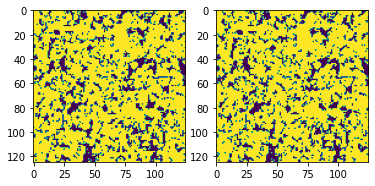

(1, 4, 125, 125, 1) (1, 1, 125, 125, 1)


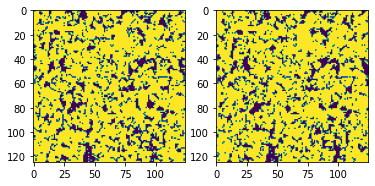

(1, 4, 125, 125, 1) (1, 1, 125, 125, 1)


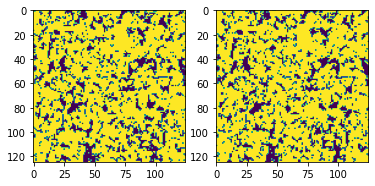

(1, 4, 125, 125, 1) (1, 1, 125, 125, 1)


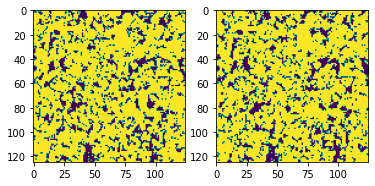

(1, 4, 125, 125, 1) (1, 1, 125, 125, 1)
[<tf.Tensor: shape=(), dtype=float32, numpy=0.033408>, <tf.Tensor: shape=(), dtype=float32, numpy=0.099328>, <tf.Tensor: shape=(), dtype=float32, numpy=0.067008>, <tf.Tensor: shape=(), dtype=float32, numpy=0.127616>]


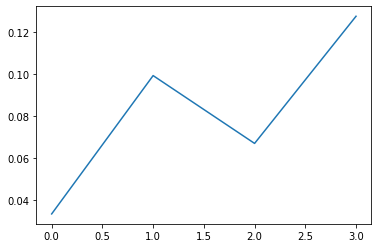

In [ ]:
for k, d in val_datasets.items():
  d_windowed = d \
    .window(10+100, shift=1, drop_remainder=True) \
    .flat_map(lambda window: window.batch(10+100)).batch(1)
  for w in d_windowed.skip(1).take(1):
    pred_err = []
    inp_slice = w[:,:10,:,:,:]
    gt_slice = w[:,10:11,:,:,:]
    for i in range(1,100):
      pred_slices = model(inp_slice, training=False)
      fig = plt.figure()
      k = 1
      for j in range(10):
        pred_slice = tf.expand_dims(pred_slices[:,j,:,:,:], 1)
        fig.add_subplot(10,3,k)
        plt.imshow(w[0,,:,:,0])
        k += 1
      plt.show()
      pred_slice = tf.expand_dims(model(inp_slice, training=False)[:,-1,:,:,:], 1)
      pred_slice_min = tf.reduce_min(pred_slice)
      pred_slice_max = tf.reduce_max(pred_slice)
      pred_slice = (pred_slice - pred_slice_min)/(pred_slice_max-pred_slice_min)
      pred_slice = tf.cast(tf.math.greater(pred_slice, 0.5), tf.float32)
      pred_err.append(tf.reduce_mean(tf.square(gt_slice-pred_slice)))

      #print(pred_slice.shape, gt_slice.shape)

      fig = plt.figure()
      fig.add_subplot(1,2,1)
      plt.imshow(gt_slice[0,0,:,:,0])
      fig.add_subplot(1,2,2)
      plt.imshow(pred_slice[0,0,:,:,0])
      plt.show()

      inp_slice = tf.concat([inp_slice[:,1:,:,:,:], pred_slice], 1)
      gt_slice = w[:,4+i:4+i+1,:,:,:]

      print(inp_slice.shape, gt_slice.shape)
    print(pred_err)
    plt.plot(pred_err)
    plt.show()

In [ ]:
pred_errs = {}
for k, d in val_datasets.items():
  d_windowed = d \
    .window(9+100, shift=1, drop_remainder=True) \
    .flat_map(lambda window: window.batch(9+100)).batch(1)
  
  pred_errs[k] = []
    pred_err = [0]*100
    for w in d_windowed:
      inp_slice = w[:,:9,:,:,:]
      gt_slice = w[:,9:9,:,:,:]
      for i in range(1,100):
        pred_slice = tf.expand_dims(model(inp_slice)[:,-1,:,:,:], 1)
        pred_slice_min = tf.reduce_min(pred_slice)
        pred_slice_max = tf.reduce_max(pred_slice)
        pred_slice = (pred_slice - pred_slice_min)/(pred_slice_max-pred_slice_min)
        pred_slice = tf.cast(tf.math.greater(pred_slice, 0.5), tf.float32)
        pred_err[i-1] += tf.reduce_mean(tf.square(gt_slice-pred_slice))
        inp_slice = tf.concat([inp_slice[:,1:,:,:,:], pred_slice], 1)
        gt_slice = w[:,9+i:9+i,:,:,:]